# Análisis Exploratorio de Datos

Guillermo Luigui Ubaldo Nieto Angarita

## Guia

https://spotintelligence.com/2023/09/15/exploratory-data-analysis-nlp/

## Diccionario de Datos

## Problema de Investigación

## Planteamiento del problema

## Pregunta de investigación

## Objetivo General

Realizar un análisis exploratorio del corpus periodístico en español proveniente de medios colombianos y mexicanos con el fin de identificar las características lingüísticas, temáticas y estructurales que influyen en la generación de preguntas y respuestas automáticas y en el rendimiento de los modelos de Question Answering (QA) durante su proceso de optimización y fine-tuning.

## Objetivos Específicos

1. Identificar las variedades lingüísticas y diferencias léxicas entre los textos periodísticos de Colombia y México.

    - Propósito: Determinar cómo las diferencias regionales del español (léxico, sintaxis, uso de expresiones y entidades) pueden influir en la comprensión automática de los modelos QA.

    - Técnicas NLP asociadas: tokenización, lematización, análisis morfosintáctico (POS tagging), TF-IDF, y Named Entity Recognition (NER).

2. Analizar las secciones periodísticas y temas predominantes para caracterizar los estilos discursivos presentes en el corpus.

    - Propósito: Explorar cómo las diferencias temáticas y estructurales por sección (Política, Economía, Cultura, Sociedad, etc.) pueden afectar la formulación y tipo de preguntas generables automáticamente.

    - Técnicas NLP asociadas: modelado de tópicos (LDA o BERTopic), análisis de frecuencia de palabras, longitud de textos y complejidad léxica.

3. Analizar las secciones periodísticas y temas predominantes para caracterizar los estilos discursivos presentes en el corpus.

    - Propósito: Explorar cómo las diferencias temáticas y estructurales por sección (Política, Economía, Cultura, Sociedad, etc.) pueden afectar la formulación y tipo de preguntas generables automáticamente.

    - Técnicas NLP asociadas: modelado de tópicos (LDA o BERTopic), análisis de frecuencia de palabras, longitud de textos y complejidad léxica.

4. Identificar patrones de entidades nombradas (NER) relevantes en los textos periodísticos.

    - Propósito: Analizar la presencia y frecuencia de entidades (PERSON, ORG, LOC, DATE, EVENT) por país y sección para detectar potenciales focos de información factual y temas para la generación de preguntas automáticas.

   - Técnicas NLP asociadas: reconocimiento de entidades, conteo de frecuencias y análisis de coocurrencia entre entidades.

4. Determinar qué tipos de preguntas y respuestas pueden generarse automáticamente a partir del análisis lingüístico y semántico del corpus.

    - Propósito: Definir el conjunto de patrones de generación QA (qué, quién, cuándo, dónde, por qué, cómo) que mejor se adapten al dominio periodístico y evaluar su distribución esperada.

    - Técnicas NLP asociadas: análisis semántico, detección de relaciones sujeto-predicado, dependency parsing, y modelos generativos (por ejemplo, T5 o GPT).

## Resultado esperado del EDA

- Identificación de las diferencias lingüísticas y estilísticas entre noticias colombianas y mexicanas.

- Determinación de los tipos de preguntas factuales e inferenciales que pueden generarse automáticamente.

- Hipótesis fundamentada sobre qué modelo y enfoque de fine-tuning podría alcanzar mejor rendimiento en comprensión lectora periodística según país o sección.

## Paso 1: Cargar Librerías

In [1]:
#!python -m spacy download es_core_news_lg

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import nltk
import re
import os
import string
import spacy
import math
import networkx as nx
import unicodedata
import unidecode


from nltk.tokenize import word_tokenize, sent_tokenize
from nltk.corpus import stopwords
from nltk.util import ngrams
from collections import Counter
from wordcloud import WordCloud
from itertools import combinations
from scipy import stats
from collections import defaultdict
from flair.data import Sentence
from flair.models import SequenceTagger
from collections import Counter
from sklearn.feature_extraction.text import TfidfVectorizer
from transformers import pipeline
from textstat import textstat
import hide_code
import ast

In [3]:
nltk.download('stopwords')
spanish_stopwords = stopwords.words('spanish')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\guill\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


## Paso 2: Cargar Datos

In [4]:
df = pd.read_excel("../datasets/exploration_datasets/silver/silver_df_news_balanced_df.xlsx")

In [5]:
# Remove "El " or "La " only at the beginning of the string (case-sensitive)
df["newspaper"] = df["newspaper"].str.replace(r'^(El|La)\s+', '', regex=True)

In [6]:
#df = pd.read_json("../datasets/exploration_datasets/silver/silver_df_news.json", lines=True)

In [7]:
df.head()

,title,category,content,country,newspaper,content_unicode,content_removed_unwanted_elements,content_lowercase,content_sentence_tokenization,content_lowercase_with_no_punctuation,content_without_stopwords,content_tokens,content_lemmes
0,¿Qué enfermedad sufrió Gabriel García Márquez ...,cultura,Se cumplen 10 años desde que ‘Gabo’ falleció.....,Colombia,Semana,Se cumplen 10 años desde que ‘Gabo’ falleció...,Se cumplen 10 anos desde que Gabo fallecio.. E...,se cumplen 10 anos desde que gabo fallecio.. e...,['se cumplen 10 anos desde que gabo fallecio.....,se cumplen 10 anos desde que gabo fallecio el ...,cumplen 10 anos gabo fallecio mundo letras vis...,cumplen 10 anos gabo fallecio mundo letras vis...,"['cumplir', 'ano', 'gabo', 'fallecio', 'mundo'..."
1,"“Tiburón: la historia de un clásico”, el docum...",cultura,"A medio siglo de su estreno, Tiburón vuelve a ...",Colombia,El Colombiano,"A medio siglo de su estreno, Tiburón vuelve a...","A medio siglo de su estreno, Tiburon vuelve a ...","a medio siglo de su estreno, tiburon vuelve a ...","['a medio siglo de su estreno, tiburon vuelve ...",a medio siglo de su estreno tiburon vuelve a e...,siglo estreno tiburon vuelve escena documental...,siglo estreno tiburon vuelve escena documental...,"['siglo', 'estreno', 'tiburon', 'vuelve', 'esc..."
2,El “boom” de la literatura latinoamericana rev...,cultura,Décadas después del movimiento que convirtió a...,Colombia,Semana,Décadas después del movimiento que convirtio...,Decadas despues del movimiento que convirtio a...,decadas despues del movimiento que convirtio a...,['decadas despues del movimiento que convirtio...,decadas despues del movimiento que convirtio a...,decadas movimiento convirtio realismo magico s...,decadas movimiento convirtio realismo magico s...,"['decada', 'movimiento', 'convirtio', 'realism..."
3,Colombia brilló en Cannes: ‘Un Poeta’ ganó el ...,cultura,La película de Simón Mesa Soto fue galardonada...,Colombia,Semana,La película de Simón Mesa Soto fue galardona...,La pelicula de Simon Mesa Soto fue galardonada...,la pelicula de simon mesa soto fue galardonada...,['la pelicula de simon mesa soto fue galardona...,la pelicula de simon mesa soto fue galardonada...,pelicula simon mesa soto galardonada seccion m...,pelicula simon mesa soto galardonada seccion m...,"['pelicula', 'simon', 'mesa', 'soto', 'galardo..."
4,Este domingo en la FILBo habrá taller familiar...,cultura,"Será un espacio para leer, soñar, reír y refle...",Colombia,Semana,"Será un espacio para leer, soñar, reír y re...","Sera un espacio para leer, sonar, reir y refle...","sera un espacio para leer, sonar, reir y refle...","['sera un espacio para leer, sonar, reir y ref...",sera un espacio para leer sonar reir y reflexi...,espacio leer sonar reir reflexionar respeto em...,espacio leer sonar reir reflexionar respeto em...,"['espacio', 'leer', 'sonar', 'reir', 'reflexio..."


In [8]:
df.tail()

,title,category,content,country,newspaper,content_unicode,content_removed_unwanted_elements,content_lowercase,content_sentence_tokenization,content_lowercase_with_no_punctuation,content_without_stopwords,content_tokens,content_lemmes
3584,“Hay que andar cazando las vacunas”: por desab...,salud,Familias crearon grupos en redes para avisar s...,Mexico,Animal Politico,Familias crearon grupos en redes para avisar s...,Familias crearon grupos en redes para avisar s...,familias crearon grupos en redes para avisar s...,['familias crearon grupos en redes para avisar...,familias crearon grupos en redes para avisar s...,familias crearon grupos redes avisar vacunas g...,familias crearon grupos redes avisar vacunas g...,"['familia', 'crear', 'grupo', 'redes', 'avisar..."
3585,Se aplaza de nuevo discusión de la reforma a l...,salud,La mesa directiva de la Comisión Séptima del S...,Mexico,Excelsior,La mesa directiva de la Comisión Séptima del...,La mesa directiva de la Comision Septima del S...,la mesa directiva de la comision septima del s...,['la mesa directiva de la comision septima del...,la mesa directiva de la comision septima del s...,mesa directiva comision septima senado anuncio...,mesa directiva comision septima senado anuncio...,"['mesa', 'directivo', 'comision', 'septimo', '..."
3586,Hospital San José ya no atenderá a pacientes d...,salud,El servicio para cientos de pacientes del régi...,Mexico,Excelsior,El servicio para cientos de pacientes del rég...,El servicio para cientos de pacientes del regi...,el servicio para cientos de pacientes del regi...,['el servicio para cientos de pacientes del re...,el servicio para cientos de pacientes del regi...,servicio cientos pacientes regimen contributiv...,servicio cientos pacientes regimen contributiv...,"['servicio', 'ciento', 'paciente', 'regimar', ..."
3587,"Quién es Hernán Bermúdez, el exsecretario de S...",seguridad,El coordinador de la bancada de Morena en el S...,Mexico,Animal Politico,El coordinador de la bancada de Morena en el S...,El coordinador de la bancada de Morena en el S...,el coordinador de la bancada de morena en el s...,['el coordinador de la bancada de morena en el...,el coordinador de la bancada de morena en el s...,coordinador bancada morena senado adan augusto...,coordinador bancada morena senado adan augusto...,"['coordinador', 'bancado', 'morena', 'senado',..."
3588,En 2023 han sido rescatados casi 900 migrantes...,seguridad,El titular de la Secretaría de Seguridad y Pro...,Mexico,Universal,El titular de la Secretaría de Seguridad y Pr...,El titular de la Secretaria de Seguridad y Pro...,el titular de la secretaria de seguridad y pro...,['el titular de la secretaria de seguridad y p...,el titular de la secretaria de seguridad y pro...,titular secretaria seguridad proteccion ciudad...,titular secretaria seguridad proteccion ciudad...,"['titular', 'secretario', 'seguridad', 'protec..."


## Paso 3: Identificar las variedades lingüísticas por ubicación geográfica, prensa escrita y tipo de sección

### Paso 3.1: Distribución y estructura general

Analizar la composición del corpus por país, periódico y sección para entender el equilibrio de los datos y la representatividad de cada fuente.

#### Paso 3.1.1: ¿Cuántas noticias hay por país (Colombia vs. México)?

In [9]:
df['country'].value_counts()

country
Colombia    2577
Mexico      1012
Name: count, dtype: int64

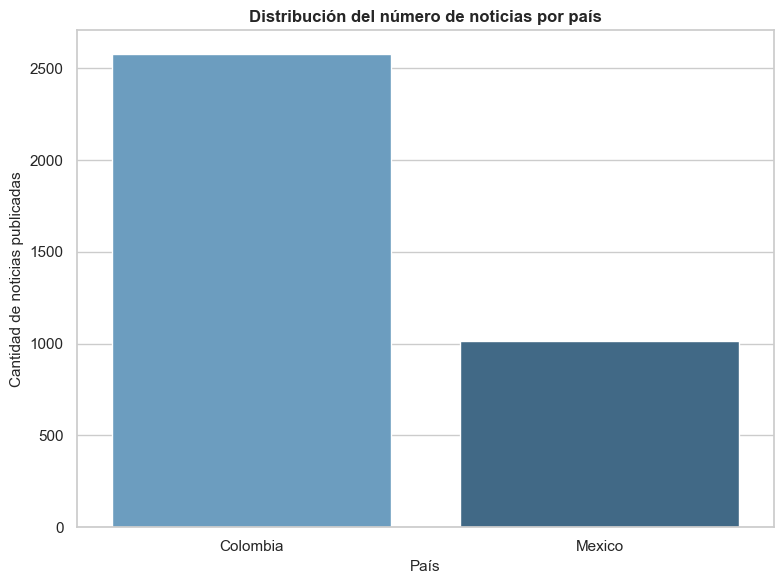

In [10]:
plt.figure(figsize=(8, 6))
sns.set_theme(style="whitegrid")  # clean academic background

sns.countplot(
    data=df,
    x='country',
    hue = 'country',
    palette="Blues_d",  # soft monochromatic palette
    legend=False
)

plt.title("Distribución del número de noticias por país", fontsize=12, fontweight='bold')
plt.xlabel("País", fontsize=11)
plt.ylabel("Cantidad de noticias publicadas", fontsize=11)
plt.tight_layout()
plt.show()

La Figura X presenta la distribución del número de noticias por país en el corpus utilizado para las tareas de question answering. Se observa que la mayoría de los textos provienen de Colombia (más de 2500), mientras que México contribuye con una cantidad menor (alrededor de 1000).

Esta diferencia indica una desproporción en la representación geográfica del corpus, lo cual puede influir en el proceso de entrenamiento o evaluación del modelo. En particular, un mayor número de textos colombianos puede hacer que el modelo aprenda patrones léxicos o contextuales más representativos de ese país, reduciendo su capacidad de generalización a otros contextos regionales del español. Por tanto, este desequilibrio debe considerarse al momento de optimizar el rendimiento y la equidad del sistema de question answering.

#### Paso 3.1.2: ¿Cuáles son los periódicos con mayor número de textos en cada país?

In [11]:
df.groupby(['country', 'newspaper']).size().reset_index(name='num_texts').sort_values(['country', 'num_texts'], ascending=[True, False])

,country,newspaper,num_texts
2,Colombia,Semana,831
0,Colombia,El Colombiano,744
1,Colombia,El Espectador,619
3,Colombia,Tiempo,383
5,Mexico,Excelsior,458
4,Mexico,Animal Politico,315
6,Mexico,Jornada,223
7,Mexico,Universal,16


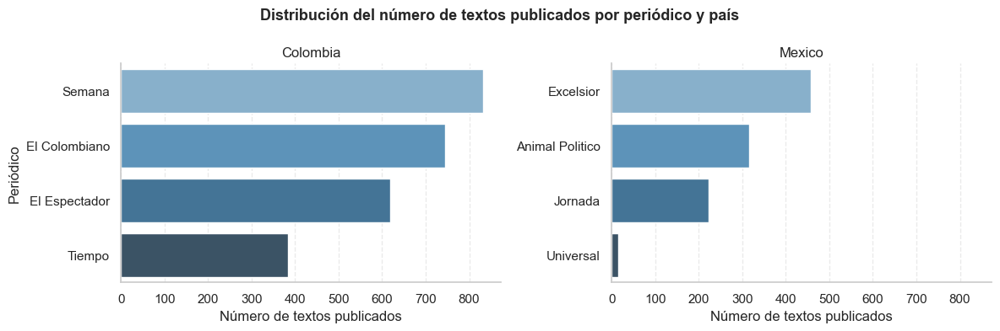

In [12]:
# --- Group the data: number of texts by newspaper and country ---
newspaper_counts = (
    df.groupby(['country', 'newspaper'])
      .size()
      .reset_index(name='num_texts')
)

# --- Sort within each country ---
newspaper_counts = newspaper_counts.sort_values(
    ['country', 'num_texts'], ascending=[True, False]
)

# --- Set academic visual style ---
sns.set_theme(style="whitegrid")

# --- Create the FacetGrid (≈6x4 per facet) ---
g = sns.FacetGrid(
    newspaper_counts,
    col='country',
    sharex=True,
    sharey=False,
    height=4,
    aspect=1.5
)

# --- Plot ---
g.map_dataframe(
    sns.barplot,
    x='num_texts',
    y='newspaper',
    hue='newspaper',
    palette='Blues_d',
    dodge=False,
    legend=False
)

# --- Customize the layout ---
g.set_titles(col_template='{col_name}')
g.set_axis_labels('Número de textos publicados', 'Periódico')
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Distribución del número de textos publicados por periódico y país',
               fontsize=13, fontweight='bold')

for ax in g.axes.flatten():
    ax.grid(True, axis='x', linestyle='--', alpha=0.4)
    ax.set_facecolor('white')

plt.tight_layout()
plt.show()


La Figura X muestra la distribución del número de textos publicados por periódico y país. Se observa un predominio de fuentes colombianas, lo que refuerza el sesgo identificado en la composición del corpus. En Colombia, los periódicos Semana y El Colombiano concentran la mayor cantidad de textos, mientras que en México, la mayoría proviene de Excélsior y Animal Político.

Esta desigualdad en la representación de fuentes puede influir en la diversidad lingüística y temática del corpus, afectando la optimización del modelo de question answering. En particular, la sobre-representación de ciertos periódicos puede inducir un sesgo estilístico o contextual, haciendo que el modelo aprenda patrones específicos de esas fuentes y disminuya su capacidad de generalización a otros medios o regiones.

#### Paso 3.1.3: ¿Qué proporción de textos hay por tipo de categoría?

In [13]:
df['category'].value_counts(normalize=True)

category
politica         0.275843
internacional    0.213430
economia         0.173586
cultura          0.152967
salud            0.138200
judicial         0.043466
seguridad        0.002508
Name: proportion, dtype: float64

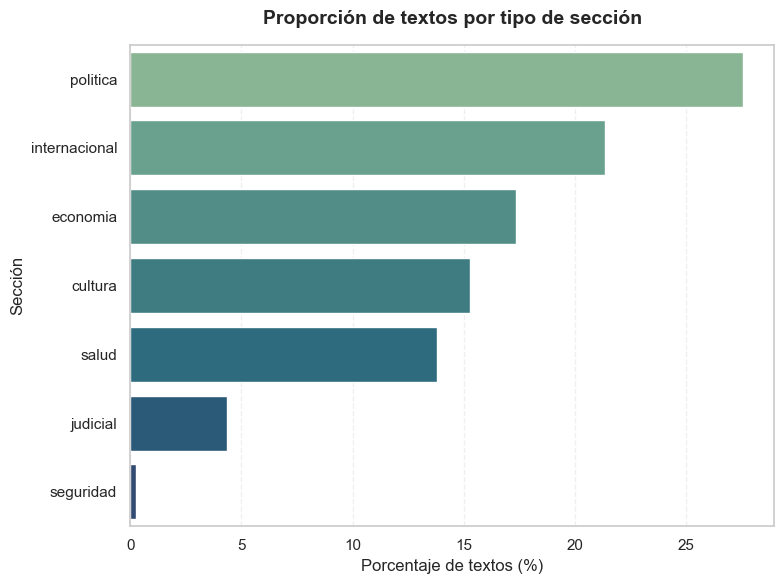

In [14]:
# --- Calcular proporción de textos por tipo de sección ---
category_counts = (
    df['category']  # 👈 corregido: 'category' en minúscula
    .value_counts(normalize=True)
    .reset_index()
)
category_counts.columns = ['category', 'percentage']
category_counts['percentage'] *= 100

# --- Crear gráfico ---
plt.figure(figsize=(8, 6))  # tamaño óptimo para tesis en Word
sns.barplot(
    data=category_counts,
    x='percentage',
    y='category',
    hue='category',
    palette='crest',  # paleta profesional y legible
    legend=False
)

# --- Personalización del gráfico ---
plt.title(
    'Proporción de textos por tipo de sección',
    fontsize=14,
    weight='bold',
    pad=15
)
plt.xlabel('Porcentaje de textos (%)', fontsize=12)
plt.ylabel('Sección', fontsize=12)
plt.grid(axis='x', linestyle='--', alpha=0.3)

# --- Ajustar diseño ---
plt.tight_layout()
plt.show()

La Figura X muestra la proporción de textos por tipo de sección en el corpus analizado. Se observa que la categoría política es la más representada, con más del 25 % de los textos, seguida de las secciones internacional, económica y cultural, que también presentan una participación significativa. En contraste, las categorías judicial y seguridad cuentan con una representación mínima.

Esta distribución evidencia un sesgo temático hacia contenidos políticos y económicos, lo cual es relevante para las tareas de question answering, ya que el modelo podría optimizar su desempeño en preguntas relacionadas con estos temas, pero mostrar rendimiento limitado en categorías con menor presencia textual. Por tanto, resulta necesario considerar estrategias de balanceo o ponderación de datos para mejorar la cobertura temática y evitar que el modelo aprenda representaciones desproporcionadas de ciertos dominios.

#### Paso 3.1.4: ¿Cómo varía la proporción de textos por tipo de sección entre Colombia y México dentro del corpus utilizado para la optimización del modelo de question answering?

C:\Users\guill\AppData\Local\Temp\ipykernel_26056\2917228533.py:19: UserWarning: The palette list has more values (8) than needed (7), which may not be intended.
  sns.barplot(


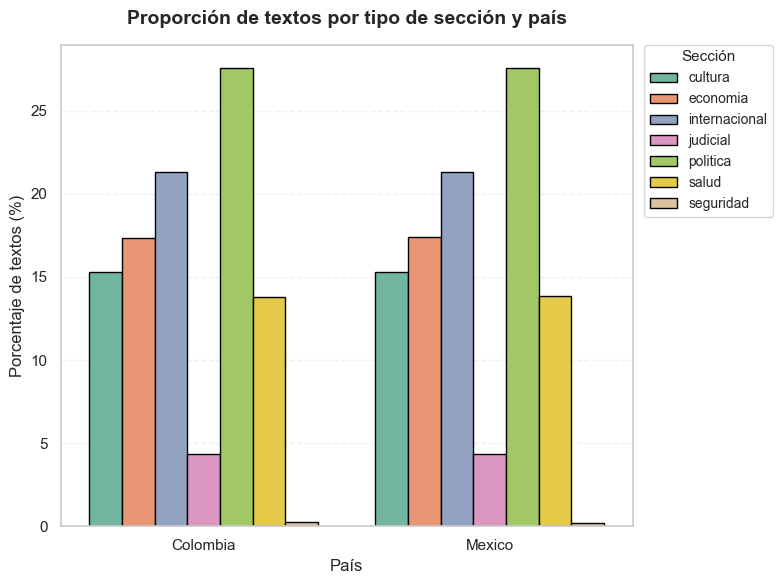

In [15]:
# --- Calcular número y proporción de textos por país y tipo de sección ---
category_counts = (
    df.groupby(['country', 'category'])
      .size()
      .reset_index(name='count')
)

category_counts['percentage'] = (
    category_counts['count'] /
    category_counts.groupby('country')['count'].transform('sum') * 100
)

# --- Crear gráfico ---
plt.figure(figsize=(8, 6))  # Tamaño estándar para tesis en Word

# Paleta con alto contraste y colorblind-safe
palette_contrast = sns.color_palette("Set2")  # Alternativas: "tab10", "Dark2", "Paired"

sns.barplot(
    data=category_counts,
    x='country',
    y='percentage',
    hue='category',
    palette=palette_contrast,
    edgecolor='black'  # bordes para resaltar barras
)

# --- Personalización ---
plt.title(
    'Proporción de textos por tipo de sección y país',
    fontsize=14,
    weight='bold',
    pad=15
)
plt.xlabel('País', fontsize=12)
plt.ylabel('Porcentaje de textos (%)', fontsize=12)
plt.xticks(fontsize=11)
plt.yticks(fontsize=11)
plt.grid(axis='y', linestyle='--', alpha=0.3)

# --- Leyenda ---
plt.legend(
    title='Sección',
    title_fontsize=11,
    fontsize=10,
    bbox_to_anchor=(1.02, 1),
    loc='upper left',
    borderaxespad=0
)

# --- Ajuste final ---
plt.tight_layout()
plt.show()



La Figura X muestra la proporción de textos por tipo de sección y país. En ambos casos, se observa un predominio de la sección política, seguida de las categorías internacional y económica. Sin embargo, las proporciones son similares entre los dos países, lo que sugiere una consistencia temática general del corpus, aunque con ligeras diferencias en las secciones cultural y salud.

Este patrón indica que, a pesar de la diferencia en el número total de textos, el contenido temático de Colombia y México mantiene una distribución comparable, lo cual es relevante para las tareas de question answering, ya que permite al modelo aprender representaciones semánticas homogéneas entre países, reduciendo el riesgo de sesgo temático.

#### Paso 3.1.5: ¿Qué longitud promedio tienen los textos (en palabras o oraciones) por país, periódico y sección?

In [16]:
df["content_sentence_tokenization"][1]

"['a medio siglo de su estreno, tiburon vuelve a escena con un documental que revela imagenes ineditas, entrevistas exclusivas y nuevas lecturas sobre la cinta que transformo el cine, el miedo a los tiburones y la conservacion marina..', 'national geographic conmemora el aniversario numero 50 del estreno de tiburon con el unico documental autorizado sobre la iconica pelicula , que contara con entrevistas nuevas a steven spielberg y se estrenara el 10 de julio en disney.', 'lea tambien: murio ron taylor, el oceanografo que filmo la pelicula tiburon titulado tiburon: la historia de un clasico , el especial es dirigido por laurent bouzereau , responsable de producciones como la musica de john williams , y producido por amblin documentaries y nedland films .', 'a lo largo de 90 minutos, el documental reconstruye el fenomeno cinematografico que no solo lanzo la carrera de spielberg, sino que transformo el cine moderno y la forma en que el mundo ve a los tiburones.', 'el documental incluye m

In [17]:
import ast

def safe_eval(x):
    if isinstance(x, list):
        return x
    if isinstance(x, str):
        try:
            val = ast.literal_eval(x)
            return val if isinstance(val, list) else []
        except (ValueError, SyntaxError):
            return []
    return []

df["content_sentence_tokenization"] = df["content_sentence_tokenization"].apply(safe_eval)

In [18]:
# Count number of sentences and words per text
df["num_sentences"] = df["content_sentence_tokenization"].apply(
    lambda x: len(x) if isinstance(x, list) else 0
)

df["num_words"] = df["content_tokens"].apply(
    lambda x: len(str(x).split()) if isinstance(x, str) else 0
)


In [19]:
# Create the grouped dataframe
avg_length = (
    df.groupby(["country", "newspaper", "category"])
    .agg(
        avg_words=("num_words", "mean"),
        avg_sentences=("num_sentences", "mean")
    )
    .reset_index()
)

# Separate and print by country
for country, group in avg_length.groupby("country"):
    print(f"\n=== {country.upper()} ===")
    print(group.sort_values(by="avg_words", ascending=False).to_string(index=False))


=== COLOMBIA ===
 country     newspaper      category  avg_words  avg_sentences
Colombia        Semana       cultura 455.983402      43.863071
Colombia El Colombiano      politica 368.578947      31.989474
Colombia        Tiempo     seguridad 358.142857      31.571429
Colombia El Colombiano      economia 327.024540      29.073620
Colombia El Colombiano       cultura 314.397059      25.720588
Colombia        Semana         salud 302.017857      23.705357
Colombia        Tiempo      politica 297.834862      25.770642
Colombia El Colombiano         salud 297.436620      22.549296
Colombia        Tiempo      economia 288.345455      21.127273
Colombia        Tiempo       cultura 278.500000      28.578947
Colombia El Colombiano internacional 277.636888      21.469741
Colombia        Semana      politica 251.074074      22.727273
Colombia        Semana      economia 248.464088      19.812155
Colombia        Tiempo         salud 214.679012      18.234568
Colombia        Tiempo internacional 

In [20]:
df[(df["country"] == "Mexico") & (df["category"] == "economica")]["content"]

Series([], Name: content, dtype: object)

C:\Users\guill\AppData\Local\Temp\ipykernel_26056\367525673.py:15: UserWarning: The palette list has more values (8) than needed (2), which may not be intended.
  sns.barplot(


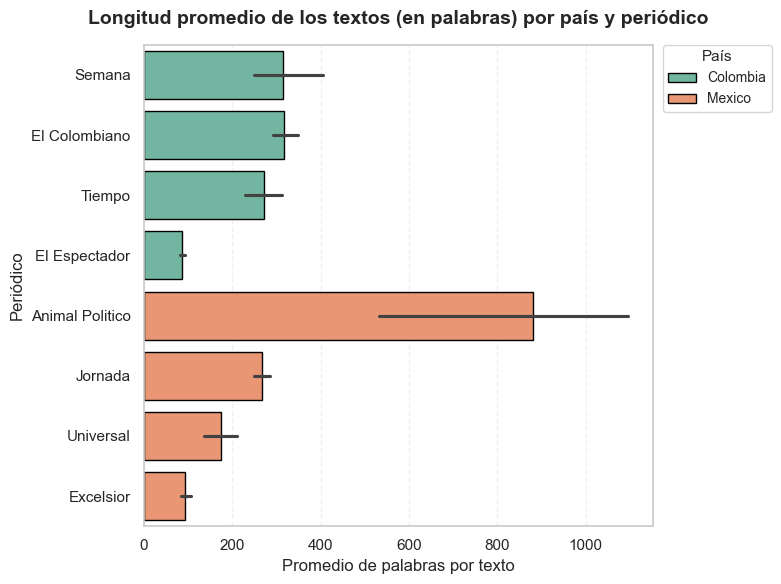

In [21]:
# --- Calcular orden de los periódicos por país y longitud promedio ---
order = (
    avg_length
    .sort_values(by=["country", "avg_words"], ascending=[True, False])
    .newspaper
    .unique()
)

# --- Crear gráfico ---
plt.figure(figsize=(8, 6))  # Tamaño óptimo para informes y tesis

# Paleta con buen contraste y accesible (colorblind-safe)
palette_contrast = sns.color_palette("Set2")  # Alternativas: "tab10" o "Dark2"

sns.barplot(
    data=avg_length,
    x="avg_words",
    y="newspaper",
    hue="country",
    order=order,
    palette=palette_contrast,
    edgecolor="black"
)

# --- Personalización del gráfico ---
plt.title(
    "Longitud promedio de los textos (en palabras) por país y periódico",
    fontsize=14,
    weight="bold",
    pad=15
)
plt.xlabel("Promedio de palabras por texto", fontsize=12)
plt.ylabel("Periódico", fontsize=12)
plt.xticks(fontsize=11)
plt.yticks(fontsize=11)
plt.grid(axis="x", linestyle="--", alpha=0.3)

# --- Leyenda ---
plt.legend(
    title="País",
    title_fontsize=11,
    fontsize=10,
    bbox_to_anchor=(1.02, 1),
    loc="upper left",
    borderaxespad=0
)

# --- Ajuste final ---
plt.tight_layout()
plt.show()


La Figura X muestra la longitud promedio de los textos (en palabras) agrupada por país y periódico. En general, los periódicos de México presentan textos más extensos que los de Colombia, destacándose Animal Político, con un promedio superior a las 900 palabras por texto. En contraste, los periódicos colombianos como Semana, El Colombiano y El Tiempo muestran longitudes promedio cercanas a las 350 palabras.

No obstante, esta diferencia también revela un posible sesgo de fuente, ya que Animal Político contribuye de manera significativa al corpus mexicano, lo que podría influir en la representación general de ese país.

Desde la perspectiva del question answering, este sesgo puede tener implicaciones importantes: los textos más largos ofrecen contextos más ricos, pero también más complejos, lo que puede afectar el tiempo de procesamiento, la precisión de extracción de respuestas y la generalización del modelo. Por tanto, este aspecto debe considerarse en las estrategias de segmentación, preprocesamiento y optimización del contexto durante el entrenamiento.

C:\Users\guill\AppData\Local\Temp\ipykernel_26056\3698018733.py:15: UserWarning: The palette list has more values (8) than needed (2), which may not be intended.
  sns.barplot(


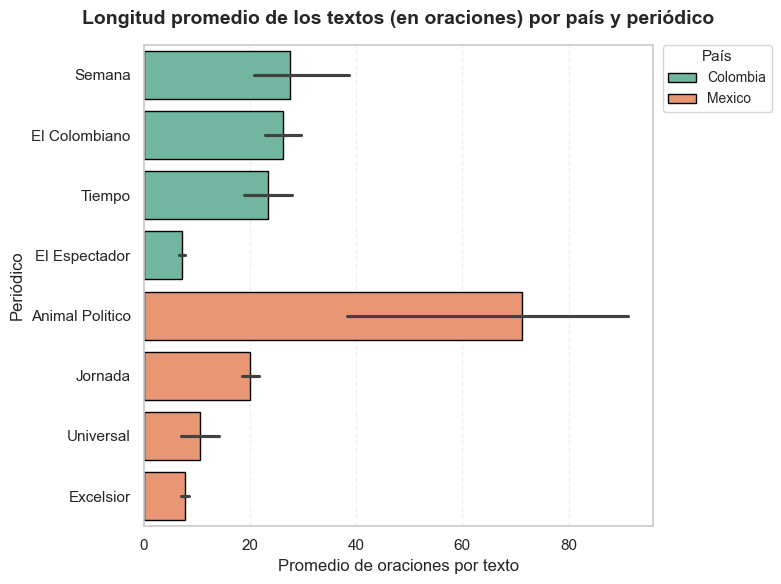

In [22]:
# --- Calcular orden de los periódicos por país y longitud promedio (en oraciones) ---
order = (
    avg_length
    .sort_values(by=["country", "avg_sentences"], ascending=[True, False])
    .newspaper
    .unique()
)

# --- Crear gráfico ---
plt.figure(figsize=(8, 6))   # Tamaño estándar para tesis

# Paleta con alto contraste y accesible (colorblind-safe)
palette_contrast = sns.color_palette("Set2")  # Alternativas: "tab10" o "Dark2"

sns.barplot(
    data=avg_length,
    x="avg_sentences",
    y="newspaper",
    hue="country",
    order=order,
    palette=palette_contrast,
    edgecolor="black"
)

# --- Personalización del gráfico ---
plt.title(
    "Longitud promedio de los textos (en oraciones) por país y periódico",
    fontsize=14,
    weight="bold",
    pad=15
)
plt.xlabel("Promedio de oraciones por texto", fontsize=12)
plt.ylabel("Periódico", fontsize=12)
plt.xticks(fontsize=11)
plt.yticks(fontsize=11)
plt.grid(axis="x", linestyle="--", alpha=0.3)

# --- Leyenda ---
plt.legend(
    title="País",
    title_fontsize=11,
    fontsize=10,
    bbox_to_anchor=(1.02, 1),
    loc="upper left",
    borderaxespad=0
)

# --- Ajuste final ---
plt.tight_layout()
plt.show()


La Figura X muestra la longitud promedio de los textos medida en oraciones, agrupada por país y periódico. En general, los textos de los periódicos mexicanos tienden a contener más oraciones que los colombianos, destacándose Animal Político con un promedio cercano a las 70 oraciones por texto. En contraste, medios colombianos como Semana, El Colombiano y El Tiempo presentan textos más breves, con alrededor de 30 oraciones en promedio.

A diferencia de la longitud en palabras, la cantidad de oraciones es un indicador más relevante para tareas de question answering, ya que determina la estructura y segmentación semántica del texto. Los textos con mayor número de oraciones ofrecen más unidades discursivas y posibles ubicaciones de respuesta, lo que puede mejorar la cobertura contextual del modelo. Sin embargo, este mismo rasgo incrementa la complejidad sintáctica y la dispersión de la información, dificultando la localización precisa de las respuestas.

En este sentido, el sesgo introducido por Animal Político —con textos sustancialmente más largos— debe considerarse en la optimización del contexto y las estrategias de segmentación, asegurando un equilibrio entre riqueza informativa y eficiencia en la extracción de respuestas.

### Paso 3.2: Variedades lingüísticas y léxicas

Propósito:
Identificar las diferencias léxicas y expresiones regionales que caracterizan las variedades del español en ambos países y secciones.

#### Paso 3.2.1: ¿Qué palabras son exclusivas o más frecuentes en los textos de Colombia frente a los de México?

In [23]:
# Normalize country names
df["country"] = df["country"].str.strip().str.capitalize()
df["country"] = df["country"].replace({"Mexico": "México"})

In [24]:
import ast

def to_lemma_list(x):
    """
    Return a list of lemmas from x, excluding the token 'ano'.
    - If x is already a list -> return it.
    - If x is a string representing a Python list -> ast.literal_eval it.
    - If x is a plain string of words -> split on whitespace.
    - Otherwise -> return empty list.
    """
    if isinstance(x, list):
        return [i for i in x if isinstance(i, str) and i.lower() != "ano"]

    if isinstance(x, str):
        s = x.strip()
        if not s:
            return []
        try:
            parsed = ast.literal_eval(s)
            if isinstance(parsed, (list, tuple)):
                return [str(i) for i in parsed if i is not None and str(i).lower() != "ano"]
        except Exception:
            return [w for w in s.split() if w.lower() != "ano"]

    return []

corpora = {}
for country in df["country"].unique():
    texts = []
    rows = df.loc[df["country"] == country, "content_lemmes"].tolist()
    for lemmas in rows:
        lem_list = to_lemma_list(lemmas)
        if lem_list:  # skip empty lists
            texts.append(" ".join(lem_list))
    corpora[country] = texts


In [25]:
top_words_list = []

for country, texts in corpora.items():
    # Remove empty or non-string entries
    texts = [t for t in texts if isinstance(t, str) and t.strip()]

    if len(texts) == 0:
        print(f"⚠️ Skipping {country}: no valid texts.")
        continue

    vectorizer = TfidfVectorizer(
        stop_words=spanish_stopwords,
        max_features=10000
    )

    try:
        tfidf = vectorizer.fit_transform(texts)
    except ValueError:
        print(f"⚠️ Skipping {country}: empty vocabulary (likely all stop words).")
        continue

    # Average TF-IDF per word
    tfidf_df = pd.DataFrame(tfidf.toarray(), columns=vectorizer.get_feature_names_out())
    mean_tfidf = tfidf_df.mean().sort_values(ascending=False).head(10)

    # Save for plotting
    top_words = pd.DataFrame({
        "word": mean_tfidf.index,
        "tfidf": mean_tfidf.values,
        "country": country
    })
    top_words_list.append(top_words)

# Combine all top words
if top_words_list:
    top_words_all = pd.concat(top_words_list, ignore_index=True)
else:
    top_words_all = pd.DataFrame(columns=["word", "tfidf", "country"])

print("\n✅ Top words computed successfully:")
print(top_words_all.head())




✅ Top words computed successfully:
         word     tfidf   country
0       petro  0.020857  Colombia
1  presidente  0.020807  Colombia
2       salud  0.020771  Colombia
3    gobierno  0.018355  Colombia
4    colombia  0.017080  Colombia


In [26]:
# Combine results
top_words_df = pd.concat(top_words_list, ignore_index=True)


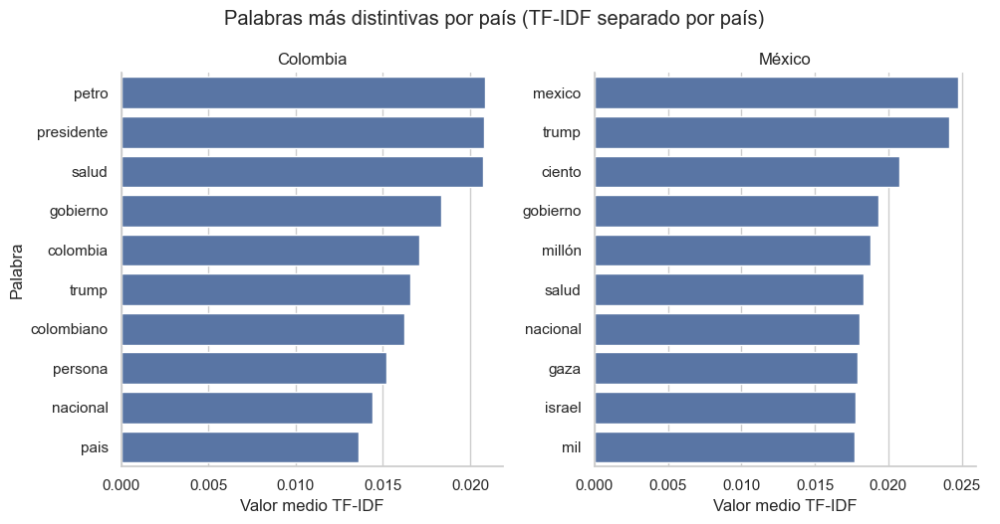

In [27]:
# Plot side-by-side by country
g = sns.catplot(
    data=top_words_df,
    x="tfidf", y="word",
    col="country",
    kind="bar",
    sharex=False, sharey=False,
    col_wrap=2,
    height=5, aspect=1
)
g.set_titles("{col_name}")
g.set_axis_labels("Valor medio TF-IDF", "Palabra")
g.fig.suptitle("Palabras más distintivas por país (TF-IDF separado por país)", y=1.05)
plt.show()

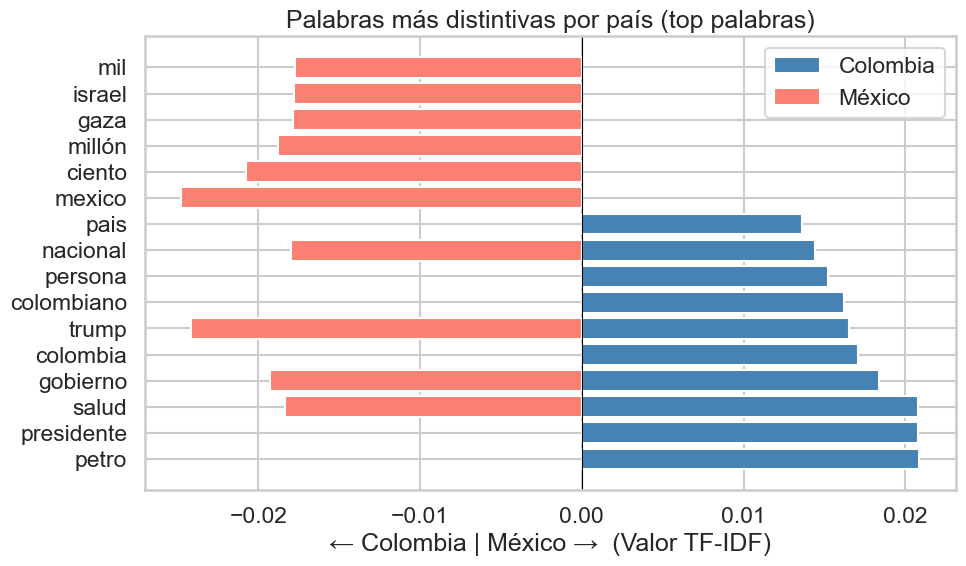

In [28]:
sns.set_style("whitegrid")
sns.set_context("talk")

# Top N palabras por país (por ejemplo 10)
top_n = 10
top_colombia = top_words_df[top_words_df["country"] == "Colombia"].nlargest(top_n, "tfidf")
top_mexico = top_words_df[top_words_df["country"] == "México"].nlargest(top_n, "tfidf")

# Preparar figura
fig, ax = plt.subplots(figsize=(10, 6))

# Barras horizontales enfrentadas
ax.barh(top_colombia["word"], top_colombia["tfidf"], color="steelblue", label="Colombia")
ax.barh(top_mexico["word"], -top_mexico["tfidf"], color="salmon", label="México")

# Línea central y etiquetas
ax.axvline(0, color='black', linewidth=0.8)
ax.set_xlabel("← Colombia | México →  (Valor TF-IDF)")
ax.set_title("Palabras más distintivas por país (top palabras)")

# Leyenda
ax.legend()

# Mejorar layout
plt.tight_layout()
plt.show()

#### Paso 3.2.2: ¿Qué palabras son más distintivas en cada categoría para los textos de Colombia y México?

In [29]:
# Normalize columns
df["country"] = df["country"].str.strip().str.capitalize()
df["country"] = df["country"].replace({"Mexico": "México"})
df["category"] = df["category"].str.strip().str.capitalize()

In [30]:
import ast

def to_lemma_list(x):
    """
    Return a list of lemmas from x, excluding the token 'ano'.
    - If x is already a list -> return it.
    - If x is a string representing a Python list -> ast.literal_eval it.
    - If x is a plain string of words -> split on whitespace.
    - Otherwise -> return empty list.
    """
    def clean_token(t):
        return isinstance(t, str) and t.lower() != "ano"

    if isinstance(x, list):
        return [i for i in x if clean_token(i)]

    if isinstance(x, str):
        s = x.strip()
        if not s:
            return []
        try:
            parsed = ast.literal_eval(s)
            if isinstance(parsed, (list, tuple)):
                return [str(i) for i in parsed if i is not None and clean_token(i)]
        except Exception:
            return [w for w in s.split() if clean_token(w)]

    return []


# --- Build nested corpora by country and category ---
corpora = {}

for (country, category), group in df.groupby(["country", "category"]):
    texts = []
    for lemmas in group["content_lemmes"]:
        lem_list = to_lemma_list(lemmas)
        if lem_list:
            texts.append(" ".join(lem_list))

    if texts:
        corpora.setdefault(country, {})[category] = texts


In [31]:
top_words_list = []

for country, categories in corpora.items():
    for category, texts in categories.items():
        # Remove empty or non-string entries
        texts = [t for t in texts if isinstance(t, str) and t.strip()]

        if len(texts) == 0:
            print(f"⚠️ Skipping {country} | {category}: no valid texts.")
            continue

        vectorizer = TfidfVectorizer(
            stop_words=spanish_stopwords,
            max_features=10000
        )

        try:
            tfidf = vectorizer.fit_transform(texts)
        except ValueError:
            print(f"⚠️ Skipping {country} | {category}: empty vocabulary (likely all stop words).")
            continue

        # Average TF-IDF per word
        tfidf_df = pd.DataFrame(tfidf.toarray(), columns=vectorizer.get_feature_names_out())
        mean_tfidf = tfidf_df.mean().sort_values(ascending=False).head(10)

        # Save for plotting or later analysis
        top_words = pd.DataFrame({
            "word": mean_tfidf.index,
            "tfidf": mean_tfidf.values,
            "country": country,
            "category": category
        })
        top_words_list.append(top_words)

# Combine all top words
if top_words_list:
    top_words_all = pd.concat(top_words_list, ignore_index=True)
else:
    top_words_all = pd.DataFrame(columns=["word", "tfidf", "country", "category"])

print("\n✅ Top words computed successfully:")
print(top_words_all.head())



✅ Top words computed successfully:
       word     tfidf   country category
0     libro  0.033750  Colombia  Cultura
1  historia  0.023201  Colombia  Cultura
2    musico  0.021057  Colombia  Cultura
3  festival  0.020931  Colombia  Cultura
4      obra  0.020638  Colombia  Cultura


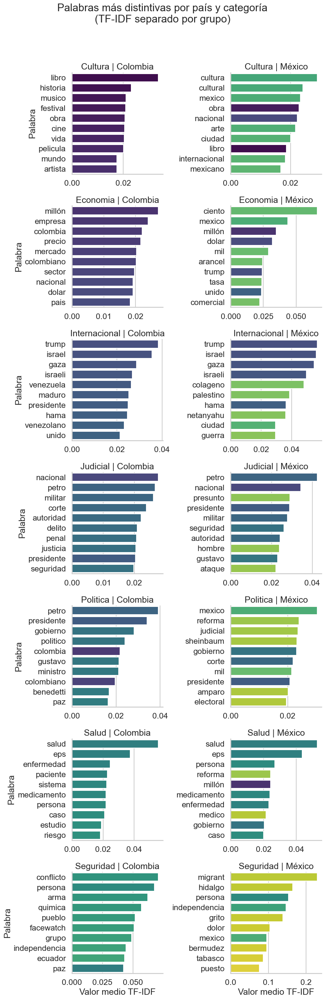

In [32]:
# Rename for clarity (optional)
top_words_df = top_words_all.copy()

# Plot: each column = country, each row = category
g = sns.catplot(
    data=top_words_df,
    x="tfidf",
    y="word",
    hue = "word",
    col="country",
    row="category",
    kind="bar",
    sharex=False, sharey=False,
    height=4, aspect=1.2,
    palette="viridis",
    legend=False
)

# Titles and labels
g.set_titles("{row_name} | {col_name}")
g.set_axis_labels("Valor medio TF-IDF", "Palabra")
g.fig.suptitle("Palabras más distintivas por país y categoría\n(TF-IDF separado por grupo)", y=1.02)

# Improve layout and show
plt.tight_layout()
plt.show()

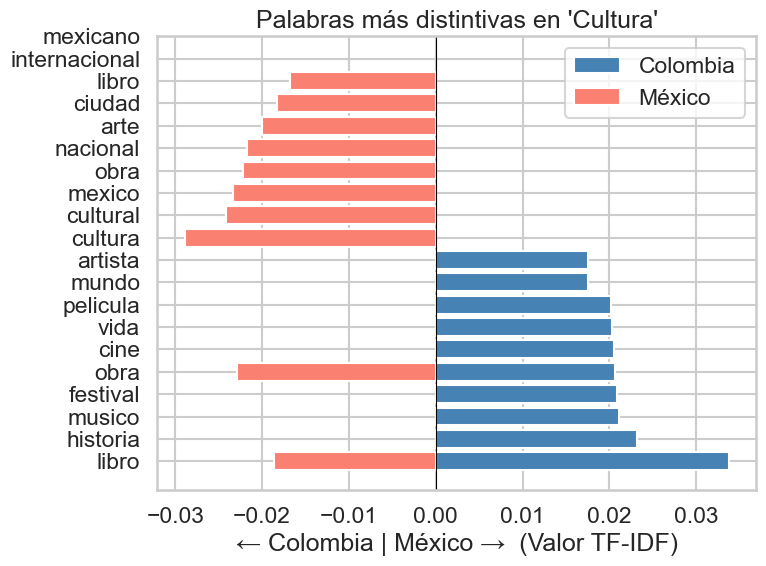

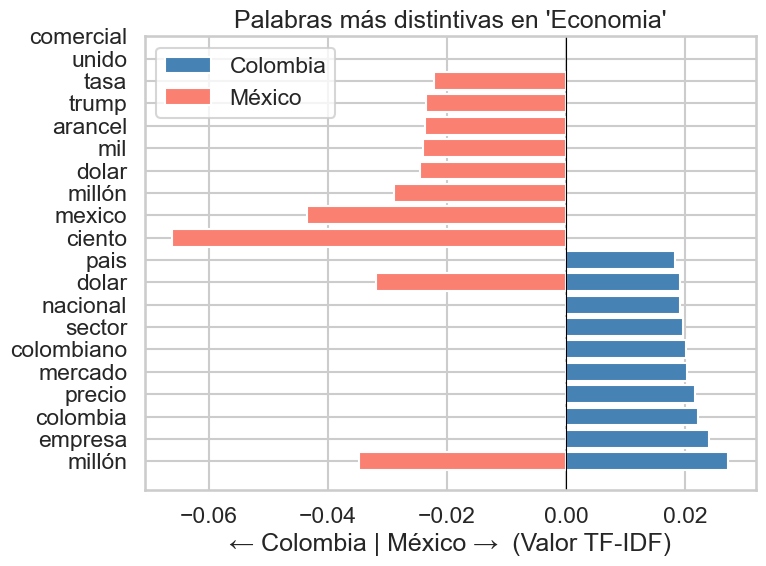

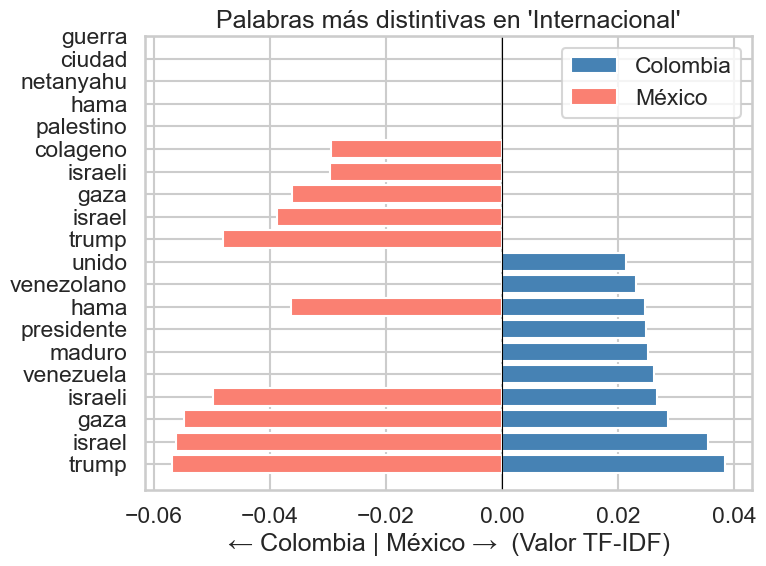

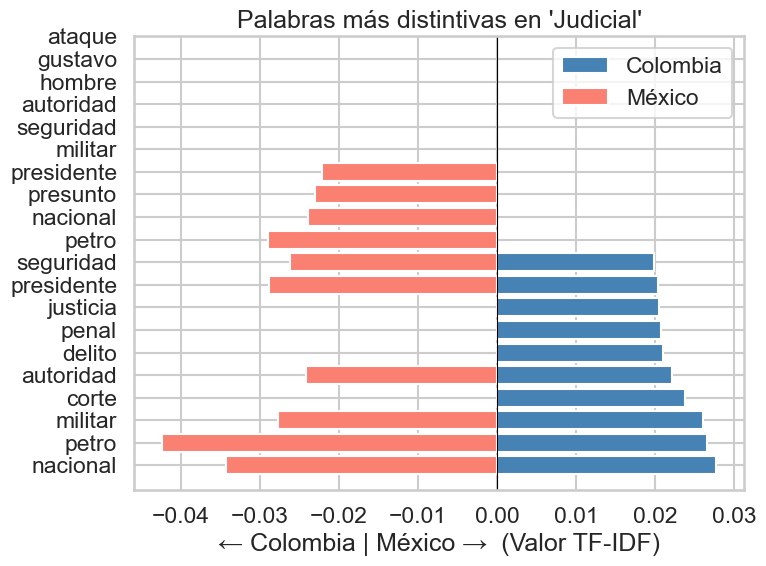

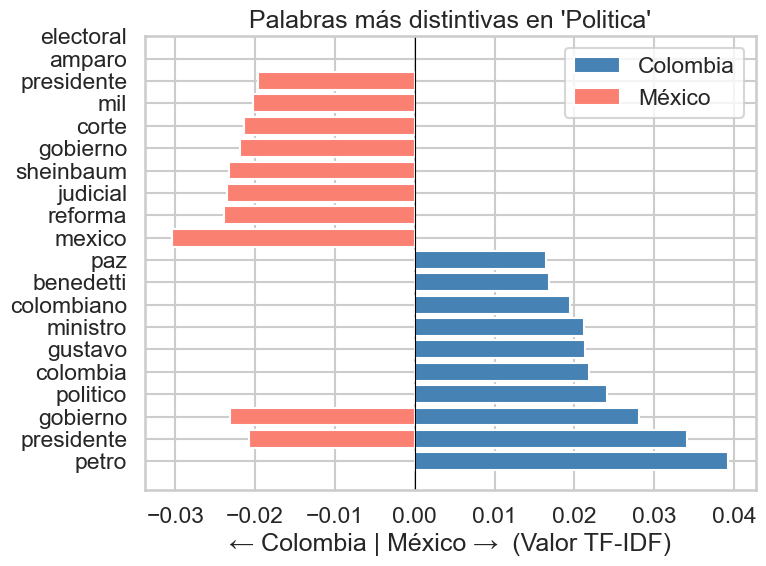

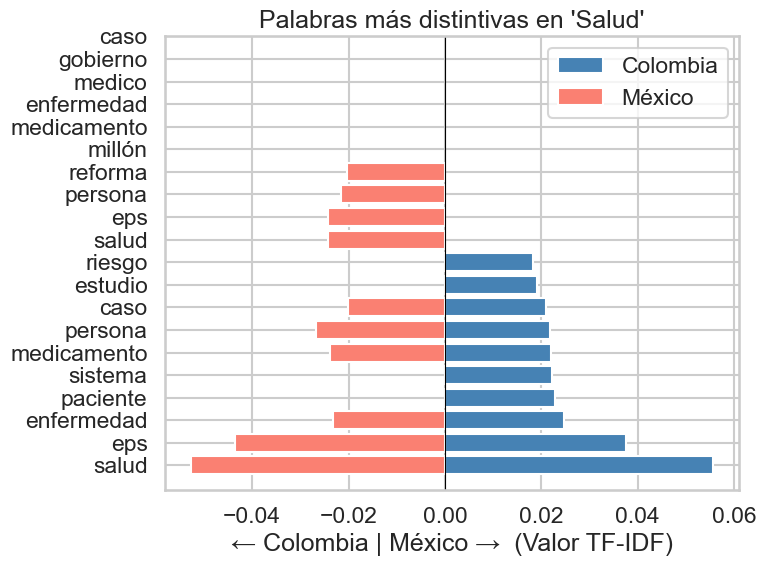

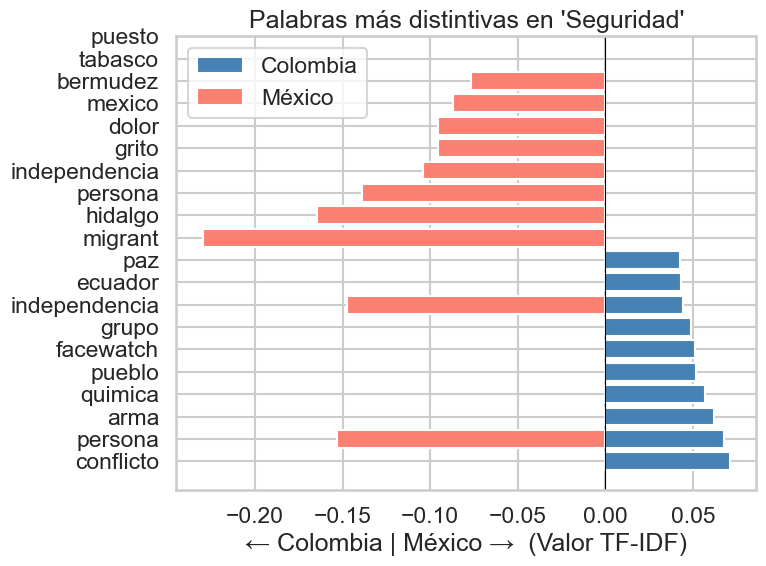

In [33]:
# Ajustes generales de estilo
sns.set_style("whitegrid")
sns.set_context("talk")

# Iterar por cada categoría
for category in top_words_df["category"].unique():
    subset = top_words_df[top_words_df["category"] == category]

    # Tomar top N palabras por país (por ejemplo, 10)
    top_colombia = subset[subset["country"] == "Colombia"].nlargest(10, "tfidf")
    top_mexico = subset[subset["country"] == "México"].nlargest(10, "tfidf")

    # Preparar figura
    fig, ax = plt.subplots(figsize=(8, 6))

    # Barras horizontales
    ax.barh(top_colombia["word"], top_colombia["tfidf"], color="steelblue", label="Colombia")
    ax.barh(top_mexico["word"], -top_mexico["tfidf"], color="salmon", label="México")

    # Etiquetas
    ax.set_xlabel("← Colombia | México →  (Valor TF-IDF)")
    ax.set_title(f"Palabras más distintivas en '{category}'")

    # Mejorar eje y: mostrar palabras completas
    ax.set_yticks(range(len(top_colombia["word"].tolist() + top_mexico["word"].tolist())))
    ax.set_yticklabels(list(top_colombia["word"]) + list(top_mexico["word"]))

    # Leyenda y línea central
    ax.axvline(0, color='black', linewidth=0.8)
    ax.legend()

    plt.tight_layout()
    plt.show()

#### Paso 3.2.3: ¿Existen diferencias en el uso de pronombres, diminutivos o modismos entre ambos países?

##### Análisis de pronombres

In [34]:
df["content_lemmes"].head()

0    ['cumplir', 'ano', 'gabo', 'fallecio', 'mundo'...
1    ['siglo', 'estreno', 'tiburon', 'vuelve', 'esc...
2    ['decada', 'movimiento', 'convirtio', 'realism...
3    ['pelicula', 'simon', 'mesa', 'soto', 'galardo...
4    ['espacio', 'leer', 'sonar', 'reir', 'reflexio...
Name: content_lemmes, dtype: object

In [37]:
df.head()

,title,category,content,country,newspaper,content_unicode,content_removed_unwanted_elements,content_lowercase,content_sentence_tokenization,content_lowercase_with_no_punctuation,content_without_stopwords,content_tokens,content_lemmes,num_sentences,num_words
0,¿Qué enfermedad sufrió Gabriel García Márquez ...,Cultura,Se cumplen 10 años desde que ‘Gabo’ falleció.....,Colombia,Semana,Se cumplen 10 años desde que ‘Gabo’ falleció...,Se cumplen 10 anos desde que Gabo fallecio.. E...,se cumplen 10 anos desde que gabo fallecio.. e...,"[se cumplen 10 anos desde que gabo fallecio..,...",se cumplen 10 anos desde que gabo fallecio el ...,cumplen 10 anos gabo fallecio mundo letras vis...,cumplen 10 anos gabo fallecio mundo letras vis...,"[cumplir, ano, gabo, fallecio, mundo, letra, v...",19,299
1,"“Tiburón: la historia de un clásico”, el docum...",Cultura,"A medio siglo de su estreno, Tiburón vuelve a ...",Colombia,El Colombiano,"A medio siglo de su estreno, Tiburón vuelve a...","A medio siglo de su estreno, Tiburon vuelve a ...","a medio siglo de su estreno, tiburon vuelve a ...","[a medio siglo de su estreno, tiburon vuelve a...",a medio siglo de su estreno tiburon vuelve a e...,siglo estreno tiburon vuelve escena documental...,siglo estreno tiburon vuelve escena documental...,"[siglo, estreno, tiburon, vuelve, escena, docu...",16,272
2,El “boom” de la literatura latinoamericana rev...,Cultura,Décadas después del movimiento que convirtió a...,Colombia,Semana,Décadas después del movimiento que convirtio...,Decadas despues del movimiento que convirtio a...,decadas despues del movimiento que convirtio a...,[decadas despues del movimiento que convirtio ...,decadas despues del movimiento que convirtio a...,decadas movimiento convirtio realismo magico s...,decadas movimiento convirtio realismo magico s...,"[decada, movimiento, convirtio, realismo, magi...",24,378
3,Colombia brilló en Cannes: ‘Un Poeta’ ganó el ...,Cultura,La película de Simón Mesa Soto fue galardonada...,Colombia,Semana,La película de Simón Mesa Soto fue galardona...,La pelicula de Simon Mesa Soto fue galardonada...,la pelicula de simon mesa soto fue galardonada...,[la pelicula de simon mesa soto fue galardonad...,la pelicula de simon mesa soto fue galardonada...,pelicula simon mesa soto galardonada seccion m...,pelicula simon mesa soto galardonada seccion m...,"[pelicula, simon, mesa, soto, galardonado, sec...",21,245
4,Este domingo en la FILBo habrá taller familiar...,Cultura,"Será un espacio para leer, soñar, reír y refle...",Colombia,Semana,"Será un espacio para leer, soñar, reír y re...","Sera un espacio para leer, sonar, reir y refle...","sera un espacio para leer, sonar, reir y refle...","[sera un espacio para leer, sonar, reir y refl...",sera un espacio para leer sonar reir y reflexi...,espacio leer sonar reir reflexionar respeto em...,espacio leer sonar reir reflexionar respeto em...,"[espacio, leer, sonar, reir, reflexionar, resp...",9,111


C:\Users\guill\AppData\Local\Temp\ipykernel_26056\4270311228.py:37: UserWarning: The palette list has more values (8) than needed (2), which may not be intended.
  sns.barplot(


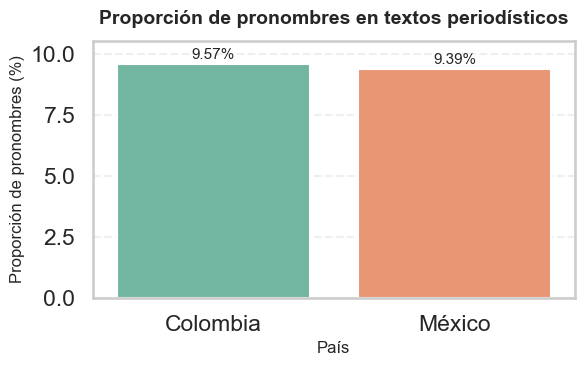

In [42]:


# Lista de pronombres
pronouns = set([
    "yo", "tú", "vos", "usted", "él", "ella", "nosotros", "nosotras",
    "ustedes", "ellos", "ellas", "me", "te", "se", "nos", "os", "lo",
    "la", "le", "los", "las", "les", "mí", "ti", "sí", "mío", "mía",
    "suyo", "suya", "nuestro", "nuestra", "este", "ese", "aquel", "esto",
    "eso", "aquello"
])

# Función para tokenizar texto
def tokenize(text):
    if not isinstance(text, str):
        return []
    return re.findall(r'\b\w+\b', text.lower())

results_pronouns = []

for country, subset in df.groupby("country"):
    tokens = [token for text in subset["content_lowercase_with_no_punctuation"] for token in tokenize(text)]
    total_tokens = len(tokens)

    if total_tokens == 0:
        pronoun_ratio = 0
    else:
        pronoun_count = sum(1 for w in tokens if w in pronouns)
        pronoun_ratio = (pronoun_count / total_tokens) * 100  # porcentaje

    results_pronouns.append({
        "country": country,
        "pronoun_ratio": pronoun_ratio
    })

pronoun_df = pd.DataFrame(results_pronouns)

plt.figure(figsize=(6, 4))  # Word-ready figure

sns.barplot(
    data=pronoun_df,
    x="country",
    y="pronoun_ratio",
    hue="country",
    palette=sns.color_palette("Set2"),  # High-contrast, accessible
    legend=False
)

plt.title(
    "Proporción de pronombres en textos periodísticos",
    fontsize=14,
    weight="bold",
    pad=12
)
plt.xlabel("País", fontsize=12)
plt.ylabel("Proporción de pronombres (%)", fontsize=12)
plt.ylim(0, pronoun_df["pronoun_ratio"].max() * 1.1)
plt.grid(axis="y", linestyle="--", alpha=0.3)

# Mostrar valores encima de cada barra
for i, row in pronoun_df.iterrows():
    plt.text(i, row["pronoun_ratio"] + 0.2, f"{row['pronoun_ratio']:.2f}%", ha='center', fontsize=11)

plt.tight_layout()
plt.show()


##### Análisis de diminutivos

C:\Users\guill\AppData\Local\Temp\ipykernel_2776\3597754254.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=diminutive_df, x="country", y="diminutive_ratio", palette="magma")


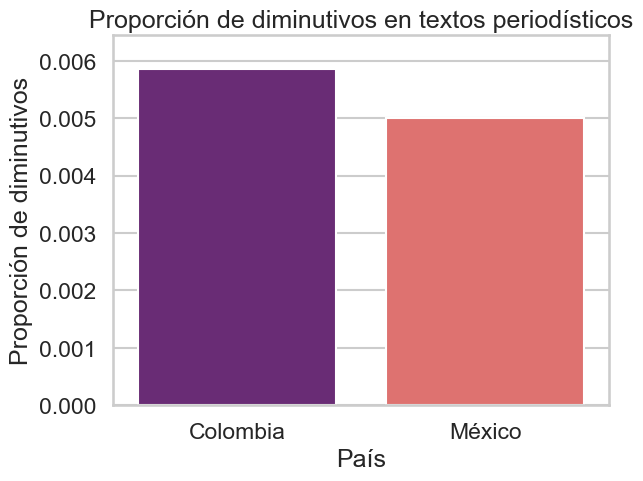

In [73]:
import re
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import ast

# Asegurarse de que content_lemmes sea una lista
def to_list(x):
    if isinstance(x, list):
        return x
    if isinstance(x, str):
        try:
            return ast.literal_eval(x)
        except:
            return []
    return []

df["content_lemmes"] = df["content_lemmes"].apply(to_list)

results_diminutives = []

for country, subset in df.groupby("country"):
    tokens = [lemma for text in subset["content_lemmes"] for lemma in text]

    if len(tokens) == 0:  # evitar división por cero
        diminutive_ratio = 0
    else:
        diminutives = [w for w in tokens if re.search(r"(ito|ita|cito|cita)$", w.lower())]
        diminutive_ratio = len(diminutives) / len(tokens)

    results_diminutives.append({
        "country": country,
        "diminutive_ratio": diminutive_ratio
    })

diminutive_df = pd.DataFrame(results_diminutives)

# Graficar
sns.barplot(data=diminutive_df, x="country", y="diminutive_ratio", palette="magma")
plt.title("Proporción de diminutivos en textos periodísticos")
plt.ylabel("Proporción de diminutivos")
plt.xlabel("País")
plt.ylim(0, diminutive_df["diminutive_ratio"].max() * 1.1)
plt.show()



##### Análisis de modismos

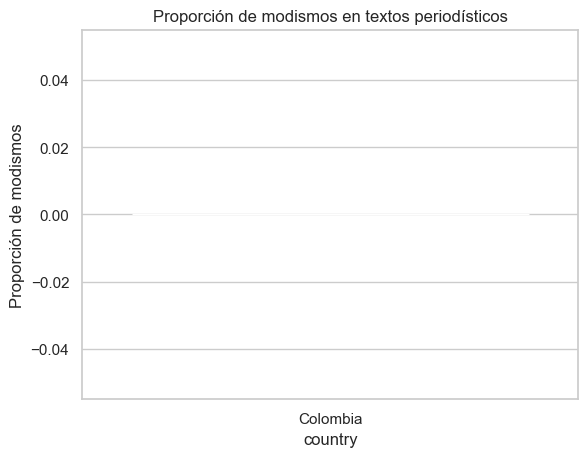

In [85]:
modismos_colombia = {"parche", "pelao", "vaina", "bacano", "chino"}
modismos_mexico = {"chido", "cuate", "lana", "padre", "güey"}

results_modismos = []

for country, subset in df.groupby("country"):
    tokens = [lemma.lower() for text in subset["content_lemmes"].dropna() for lemma in text]
    if country.lower() == "colombia":
        modismos = modismos_colombia
    elif country.lower() == "mexico":
        modismos = modismos_mexico
    else:
        continue

    count_modismos = sum(1 for w in tokens if w in modismos)
    results_modismos.append({
        "country": country,
        "modismo_ratio": count_modismos / len(tokens)
    })

modismo_df = pd.DataFrame(results_modismos)
sns.barplot(data=modismo_df, x="country", y="modismo_ratio")
plt.title("Proporción de modismos en textos periodísticos")
plt.ylabel("Proporción de modismos")
plt.show()

#### Paso 3.2.4: ¿Qué términos o expresiones regionales aparecen con mayor frecuencia por sección?

In [86]:
# Crear una estructura para guardar las palabras más comunes por país y categoría
regional_terms = {}

for country in df["country"].unique():
    regional_terms[country] = {}
    country_df = df[df["country"] == country]

    for category in country_df["category"].unique():
        # Unir todas las listas de lemas de esa categoría
        all_lemmes = sum(country_df[country_df["category"] == category]["content_lemmes"].tolist(), [])

        # Contar frecuencia
        counter = Counter(all_lemmes)

        # Seleccionar las más frecuentes (ajusta n según tu preferencia)
        most_common = counter.most_common(20)

        regional_terms[country][category] = pd.DataFrame(most_common, columns=["term", "frequency"])



TypeError: can only concatenate list (not "str") to list

In [34]:
regional_terms

{'México': {'Internacional':               term  frequency
  0            trump       2068
  1           israel       1794
  2             gaza       1631
  3              ano       1550
  4          israeli       1514
  5          persona       1261
  6         gobierno       1229
  7              bbc       1182
  8        palestino       1135
  9           guerra       1027
  10          ciudad        999
  11           poder        947
  12           mundo        937
  13            hama        936
  14       netanyahu        877
  15      presidente        821
  16        colageno        819
  17           unido        800
  18         rodilla        769
  19  estadounidense        768,
  'Politica':           term  frequency
  0       mexico        925
  1     gobierno        692
  2    sheinbaum        629
  3     judicial        593
  4          mil        556
  5      reforma        546
  6     nacional        530
  7          ano        521
  8     politico        520
  9     

In [35]:
# Ejemplo: ver los términos más comunes de "Mexico" en la categoría "Economía"
regional_terms["México"]["Economica"].head(10)

,term,frequency
0,ciento,497
1,mexico,338
2,ano,222
3,millón,217
4,mil,180
5,dolar,166
6,unido,160
7,arancel,140
8,trump,139
9,mexicano,138


C:\Users\guill\AppData\Local\Temp\ipykernel_59120\3206556652.py:19: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda x: x.nlargest(10, "frequency"))


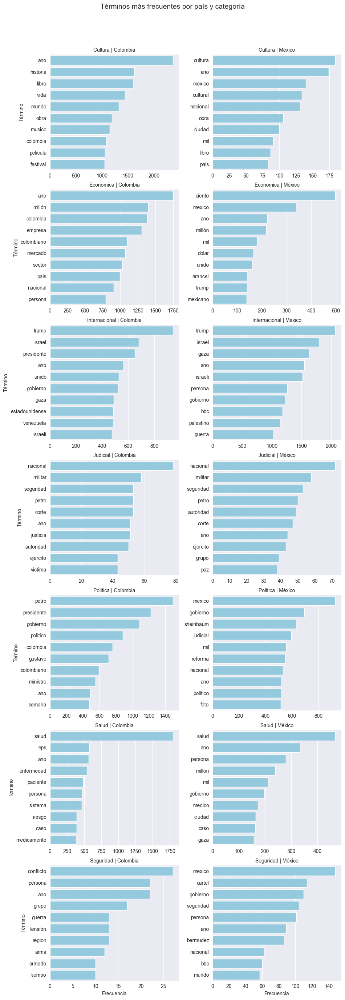

In [36]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Combine results into one DataFrame
plot_df_all = []
for country in regional_terms.keys():
    for category in regional_terms[country].keys():
        temp_df = regional_terms[country][category].copy()
        temp_df["country"] = country
        temp_df["category"] = category
        plot_df_all.append(temp_df)

plot_df_all = pd.concat(plot_df_all)

# Keep top 10 most frequent terms per (country, category)
plot_df_all = (
    plot_df_all.groupby(["country", "category"], group_keys=False, observed=True)
    .apply(lambda x: x.nlargest(10, "frequency"))
    .reset_index(drop=True)
)


# Create one grid of plots: columns = countries, rows = categories
g = sns.FacetGrid(
    plot_df_all,
    col="country",
    row="category",
    sharex=False,
    sharey=False,
    height=4,
    aspect=1.2
)

# Add barplots to each facet
g.map_dataframe(
    sns.barplot,
    x="frequency",
    y="term",
    color="skyblue"
)

# Adjust layout and titles
g.set_titles(row_template="{row_name}", col_template="{col_name}")
g.set_axis_labels("Frecuencia", "Término")
plt.subplots_adjust(top=0.93)
g.fig.suptitle("Términos más frecuentes por país y categoría", fontsize=14)
plt.show()

#### Paso 3.2.5: ¿Qué diferencias hay en las palabras más frecuentes por periódico dentro del mismo país?

C:\Users\guill\AppData\Local\Temp\ipykernel_59120\3578012932.py:31: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda x: x.nlargest(10, "tfidf"))
C:\Users\guill\AppData\Local\Temp\ipykernel_59120\3578012932.py:56: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend(title="Periódico", fontsize=8)


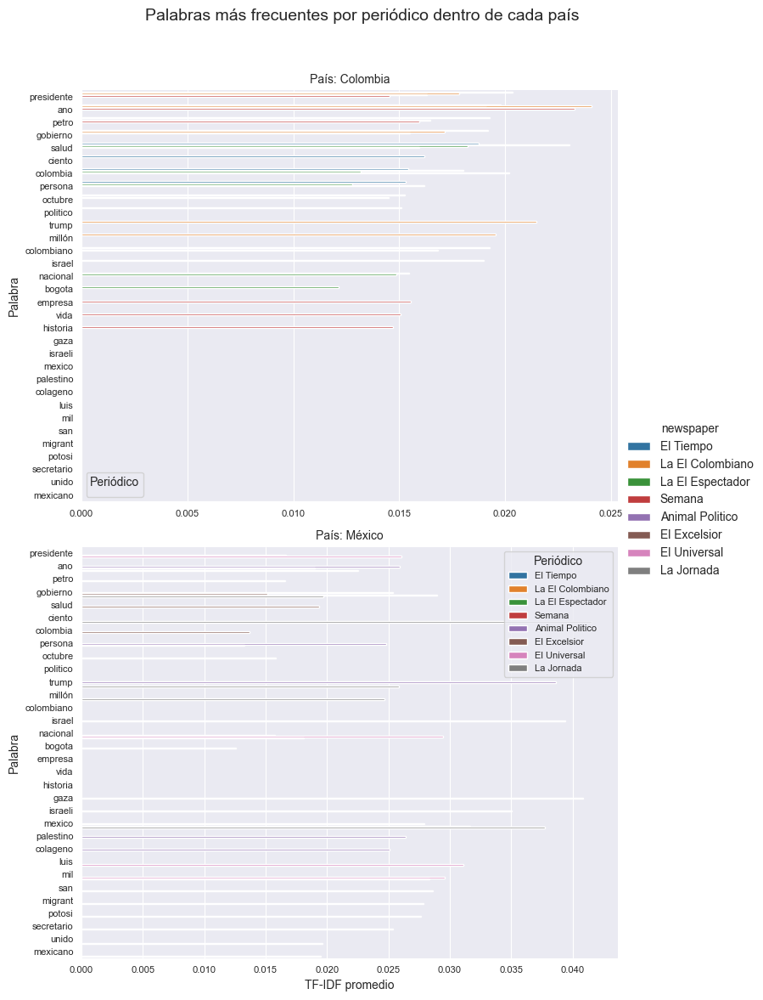

In [37]:
results = []

# Calcular TF-IDF por (país, periódico)
for (country, newspaper), subset in df.groupby(["country", "newspaper"]):
    texts = subset["content_lemmes"].dropna().tolist()
    if len(texts) == 0:
        continue

    # Unir los lemas en cadenas de texto
    texts = [" ".join(t) for t in texts]

    vectorizer = TfidfVectorizer(stop_words=spanish_stopwords, max_features=10000)
    tfidf = vectorizer.fit_transform(texts)
    tfidf_df = pd.DataFrame(tfidf.toarray(), columns=vectorizer.get_feature_names_out())

    mean_tfidf = tfidf_df.mean().sort_values(ascending=False).head(10)

    temp = pd.DataFrame({
        "word": mean_tfidf.index,
        "tfidf": mean_tfidf.values,
        "country": country,
        "newspaper": newspaper
    })
    results.append(temp)

freq_df = pd.concat(results, ignore_index=True)

# Seleccionar las 10 palabras más relevantes por periódico
freq_df_top = (
    freq_df.groupby(["country", "newspaper"], group_keys=False)
    .apply(lambda x: x.nlargest(10, "tfidf"))
    .reset_index(drop=True)
)

# Increase figure size and layout
g = sns.catplot(
    data=freq_df_top,
    x="tfidf", y="word",
    hue="newspaper",
    col="country",
    kind="bar",
    dodge=True,
    sharex=False,
    height=6, aspect=1.3,
    col_wrap=1  # ✅ One country per row for clarity
)

# Improve title and labels
g.set_titles("País: {col_name}")
g.set_axis_labels("TF-IDF promedio", "Palabra")

# Make text smaller and readable
for ax in g.axes.flat:
    ax.tick_params(axis='y', labelsize=8)
    ax.tick_params(axis='x', labelsize=8)
    ax.legend(title="Periódico", fontsize=8)

plt.subplots_adjust(top=0.9)
plt.suptitle("Palabras más frecuentes por periódico dentro de cada país", fontsize=14)
plt.show()


#### Paso 3.2.5: ¿Se observan diferencias en el uso de tiempos verbales o estructuras sintácticas entre países?

### Paso 3.3 Reconocimiento de entidades y temas dominantes (NER + Topic Modeling)

Propósito:
Detectar las entidades nombradas y los temas principales en las noticias para comprender las diferencias semánticas y discursivas entre países y secciones, así como posibles focos temáticos que influyan en la generación de preguntas y en el rendimiento de los modelos QA.

#### Paso 3.3.1: ¿Qué entidades nombradas (PERSON, LOC, ORG, DATE, EVENT) aparecen con mayor frecuencia por país y por categoria?

##### Paso 3.3.1.1: Con spaCy

In [74]:
nlp = spacy.load("es_core_news_lg")

In [75]:
def extract_entities_spacy(text):
    """Extract (entity_text, entity_label) pairs from text."""
    doc = nlp(text)
    entities = [(ent.text, ent.label_) for ent in doc.ents]
    return entities

In [76]:
df["entities"] = df["content_lemmes"].apply(
    lambda lemmas: extract_entities_spacy(" ".join(lemmas)) if isinstance(lemmas, list) else []
)

In [77]:
# --- 2. Expandir el DataFrame ---
entity_rows = []
for _, row in df.iterrows():
    for ent_text, ent_label in row["entities"]:
        entity_rows.append({
            "country": row["country"],
            "category": row["category"],
            "entity": ent_text.strip(),
            "type": ent_label
        })

entity_df = pd.DataFrame(entity_rows)

In [78]:
# --- 3. Calcular frecuencia de cada entidad ---
entity_freq = (
    entity_df.groupby(["country", "category", "type", "entity"])
    .size()
    .reset_index(name="frequency")
)

In [79]:
# --- 4. Seleccionar las 30 más frecuentes por país y sección ---
top_entities = (
    entity_freq.groupby(["country", "category", "type"], group_keys=False)
    .apply(lambda x: x.nlargest(30, "frequency"))
    .reset_index(drop=True)
)

C:\Users\guill\AppData\Local\Temp\ipykernel_2776\3759326587.py:4: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda x: x.nlargest(30, "frequency"))


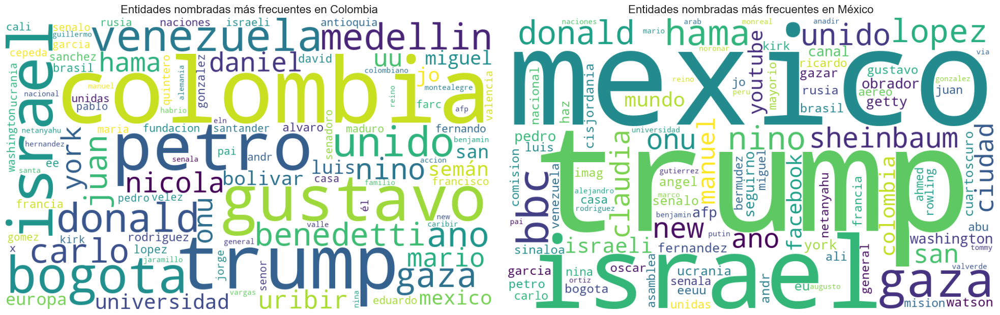

In [80]:
# Define the two countries to compare
countries = ["Colombia", "México"]

# Prepare a figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(20, 8))

for ax, country in zip(axes, countries):
    # Extract entity texts
    entities_texts = df[df["country"] == country]["entities"].explode().dropna()
    entities_texts = [ent[0] for ent in entities_texts if isinstance(ent, tuple)]

    # Skip if no entities found
    if len(entities_texts) == 0:
        ax.set_title(f"{country} – sin datos")
        ax.axis("off")
        continue

    # Generate word cloud
    text = " ".join(entities_texts)
    wc = WordCloud(
        width=1000,
        height=600,
        background_color="white",
        max_words=100,
        collocations=False
    ).generate(text)

    # Display side-by-side
    ax.imshow(wc, interpolation="bilinear")
    ax.axis("off")
    ax.set_title(f"Entidades nombradas más frecuentes en {country}", fontsize=16)

plt.tight_layout()
plt.show()

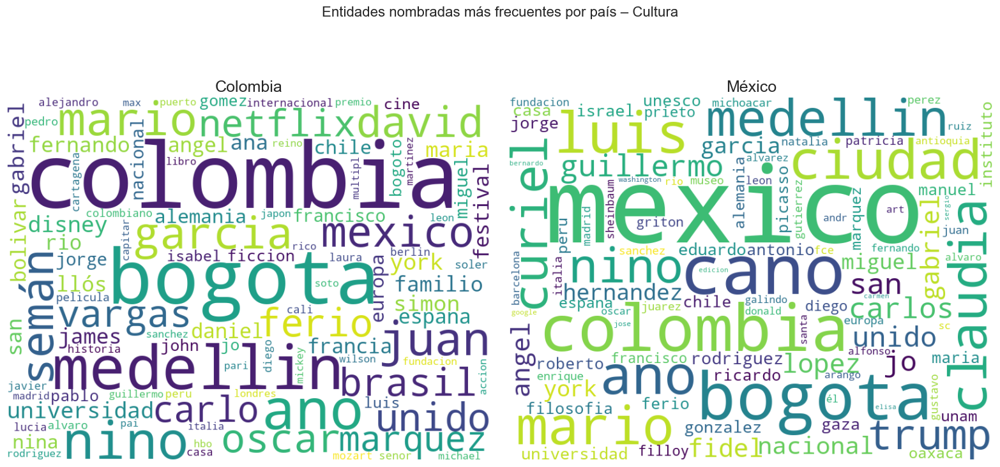

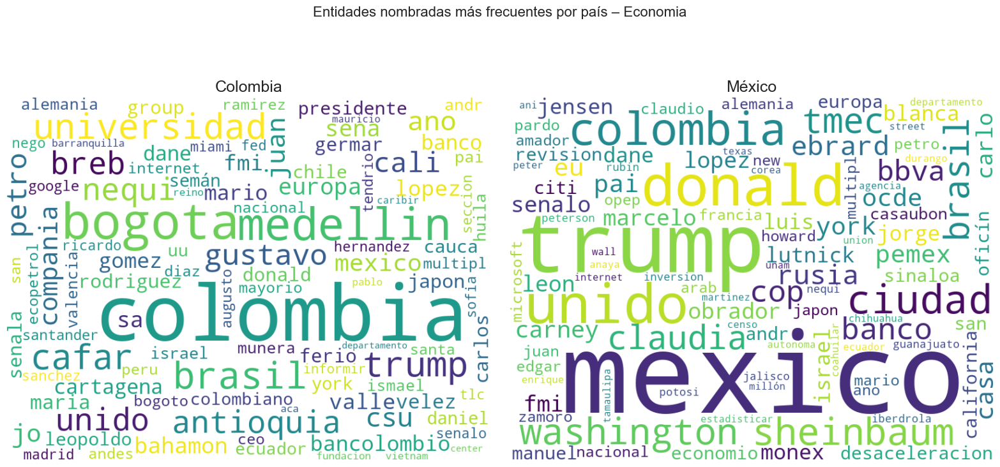

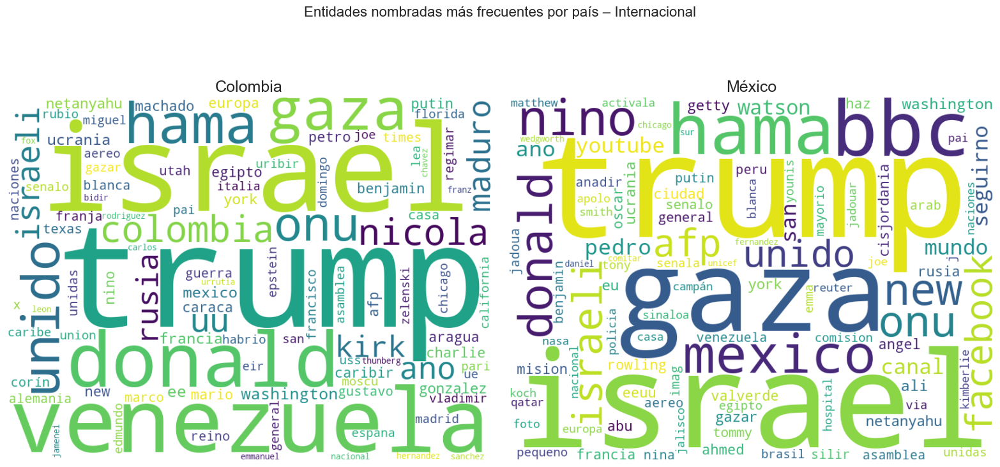

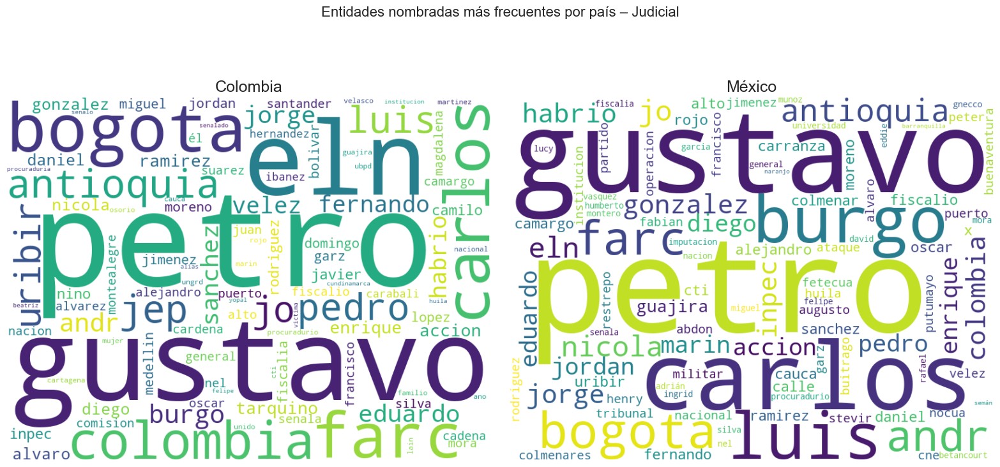

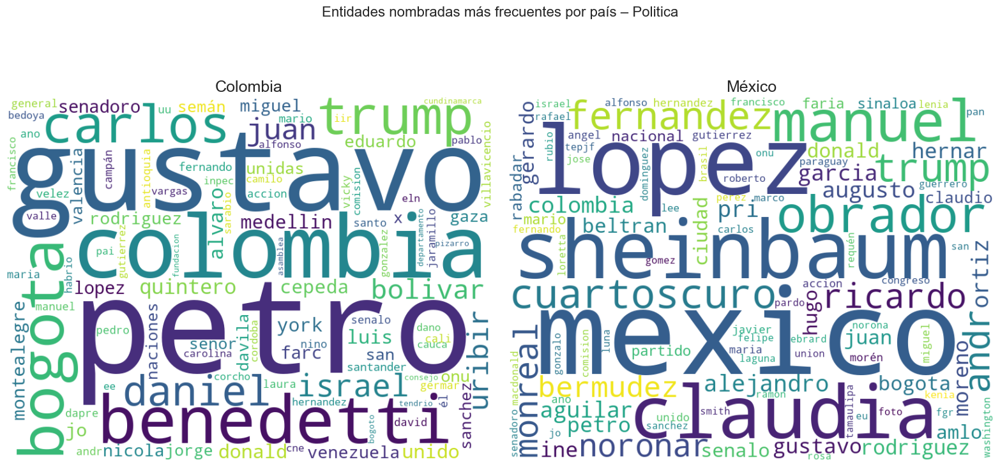

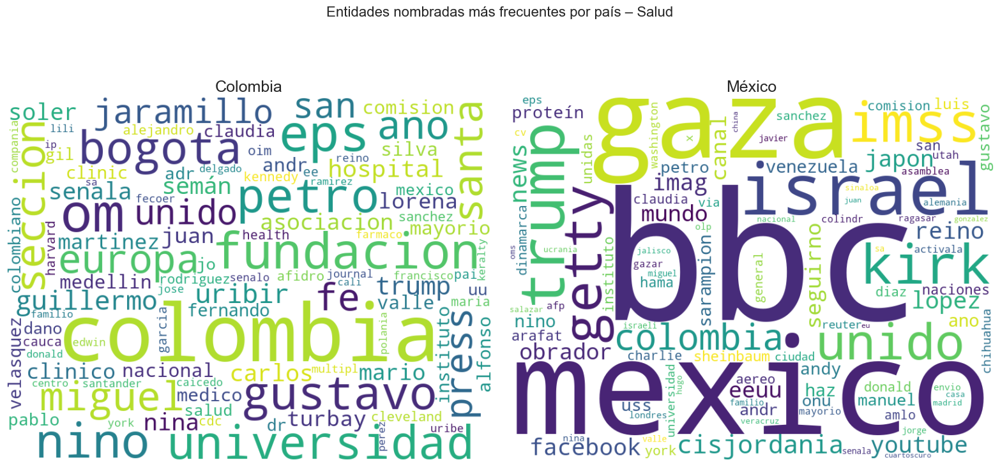

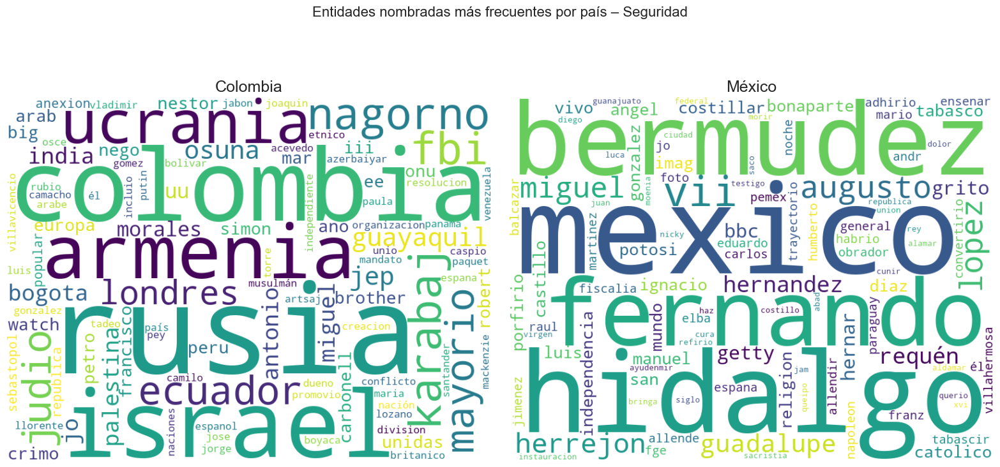

In [81]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

countries = ["Colombia", "México"]  # adjust if spelling differs

for category in df["category"].unique():
    fig, axes = plt.subplots(1, 2, figsize=(16, 8))
    fig.suptitle(f"Entidades nombradas más frecuentes por país – {category}", fontsize=16)

    for i, country in enumerate(countries):
        subset = df[(df["country"] == country) & (df["category"] == category)]
        entities_texts = subset["entities"].explode().dropna()
        entities_texts = [ent[0] for ent in entities_texts if isinstance(ent, tuple)]

        if len(entities_texts) == 0:
            axes[i].axis("off")
            axes[i].set_title(f"{country} – sin datos")
            continue

        text = " ".join(entities_texts)
        wc = WordCloud(
            width=800, height=600,
            background_color="white",
            max_words=100,
            collocations=False
        ).generate(text)

        axes[i].imshow(wc, interpolation="bilinear")
        axes[i].axis("off")
        axes[i].set_title(f"{country}")

    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()



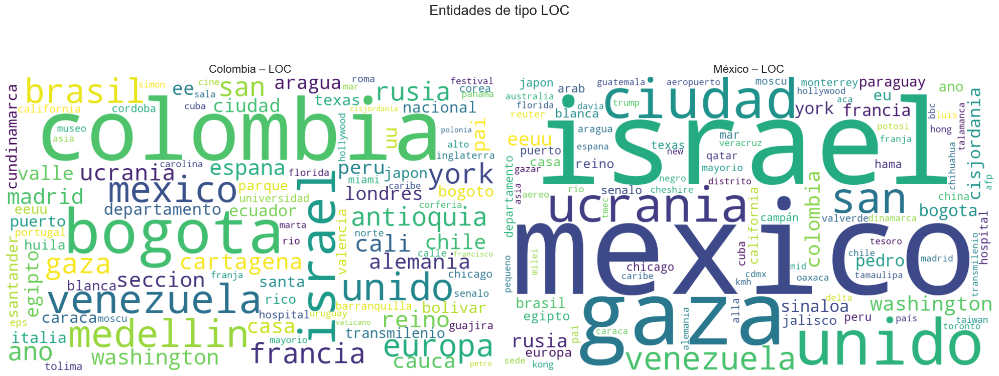

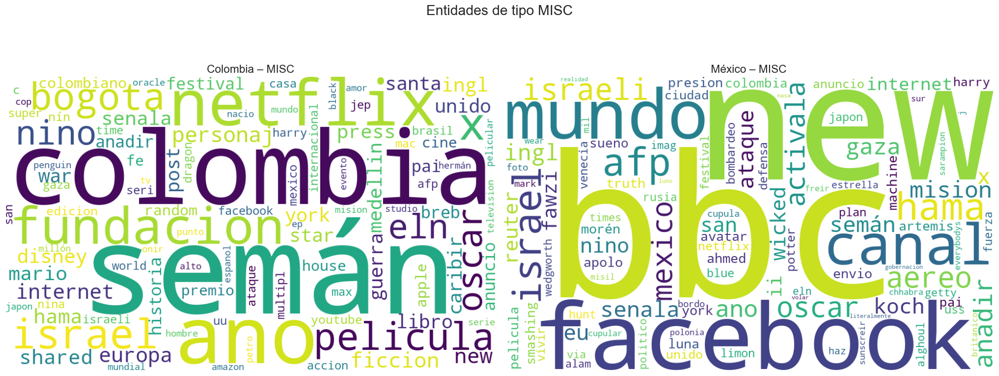

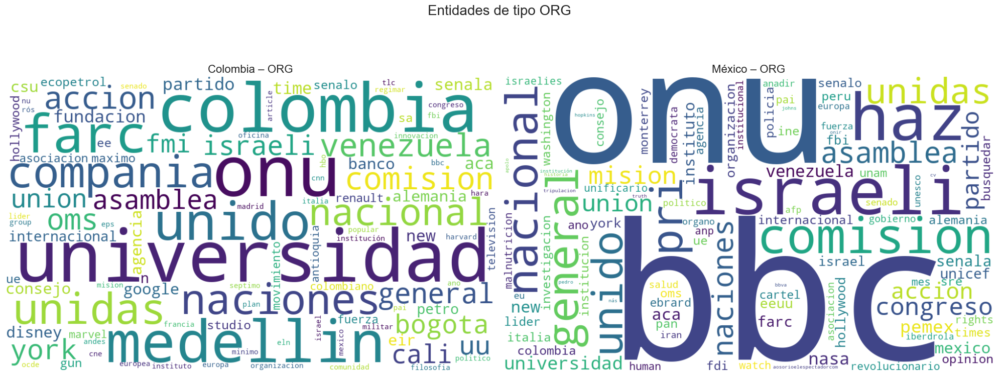

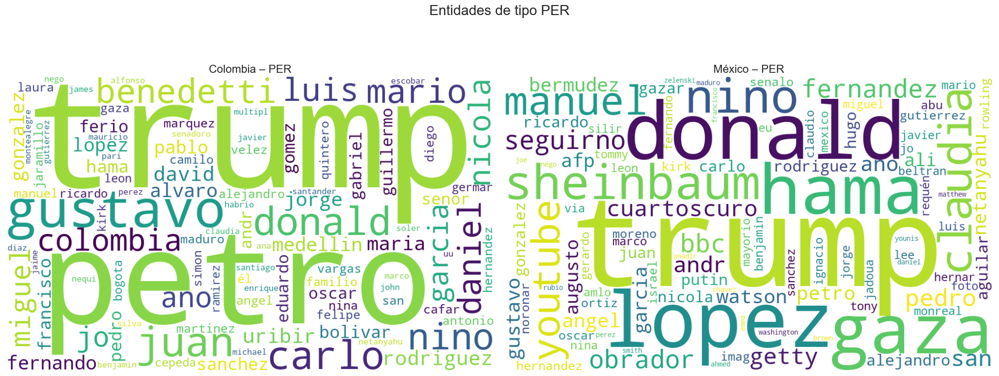

In [46]:
# Get all unique entity types across both countries
entity_types = sorted(
    set(
        ent[1]
        for ents in df["entities"].dropna().explode()
        if isinstance(ents, tuple)
        for ent in [ents]
    )
)

countries = ["Colombia", "México"]

# Loop over entity types
for entity_type in entity_types:
    fig, axes = plt.subplots(1, 2, figsize=(20, 8))

    for ax, country in zip(axes, countries):
        # Extract entities of this type for each country
        entities_texts = df[df["country"] == country]["entities"].explode().dropna()
        entities_texts = [ent[0] for ent in entities_texts if isinstance(ent, tuple) and ent[1] == entity_type]

        # Skip if none
        if len(entities_texts) == 0:
            ax.set_title(f"{country} – sin datos", fontsize=14)
            ax.axis("off")
            continue

        # Generate WordCloud
        text = " ".join(entities_texts)
        wc = WordCloud(
            width=1000, height=600,
            background_color="white",
            max_words=100,
            collocations=False
        ).generate(text)

        ax.imshow(wc, interpolation="bilinear")
        ax.axis("off")
        ax.set_title(f"{country} – {entity_type}", fontsize=16)

    fig.suptitle(f"Entidades de tipo {entity_type}", fontsize=20, y=1.02)
    plt.tight_layout()
    plt.show()

=== INTERNACIONAL ===


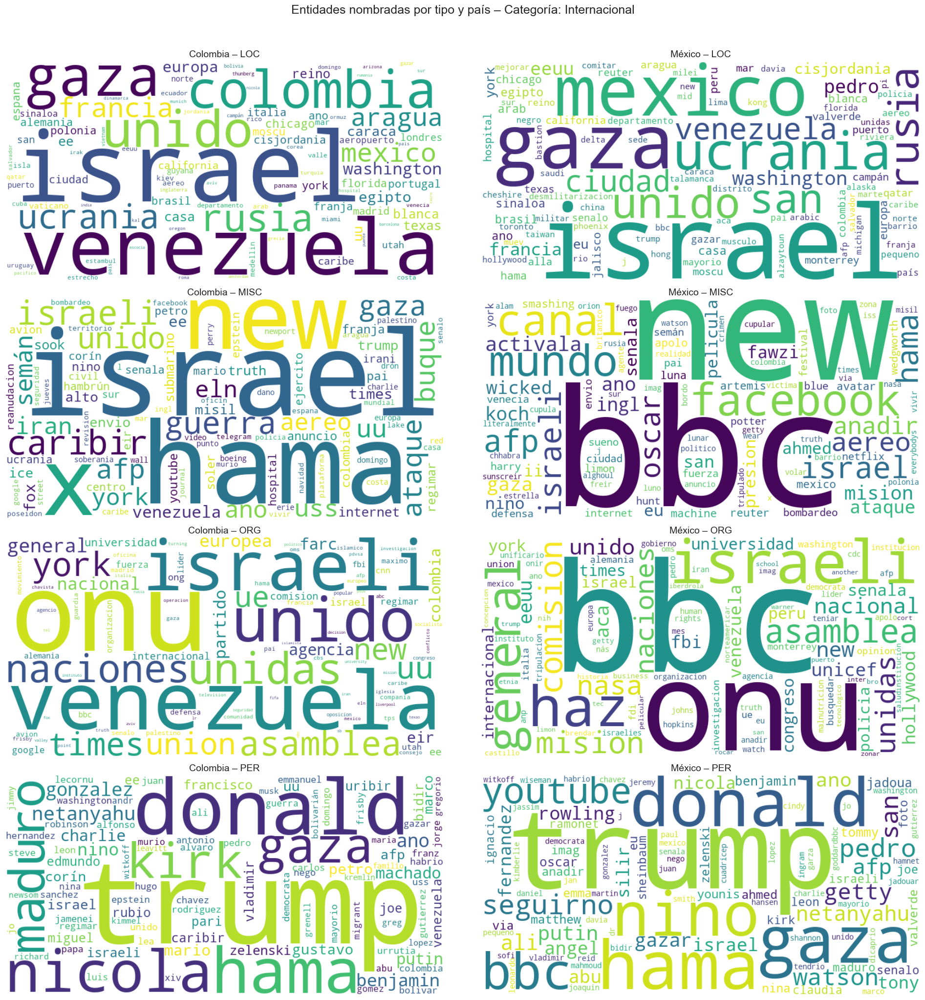

=== POLITICA ===


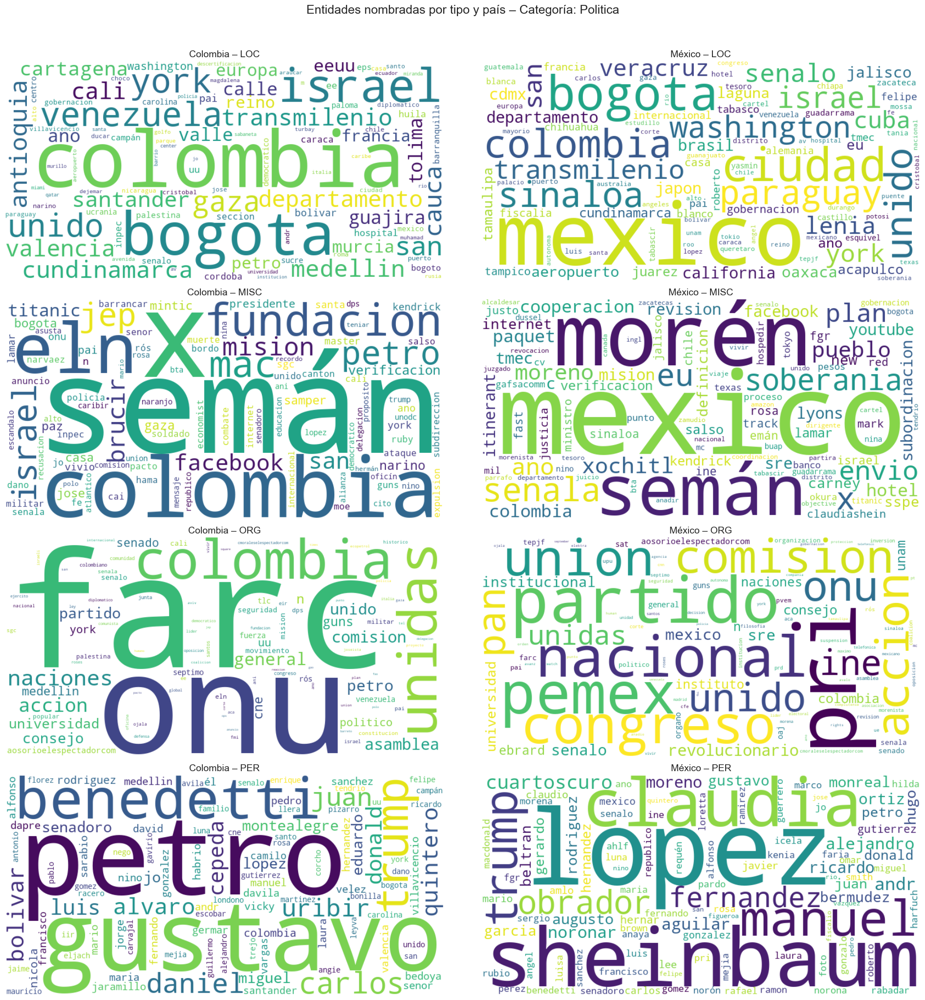

=== SALUD ===


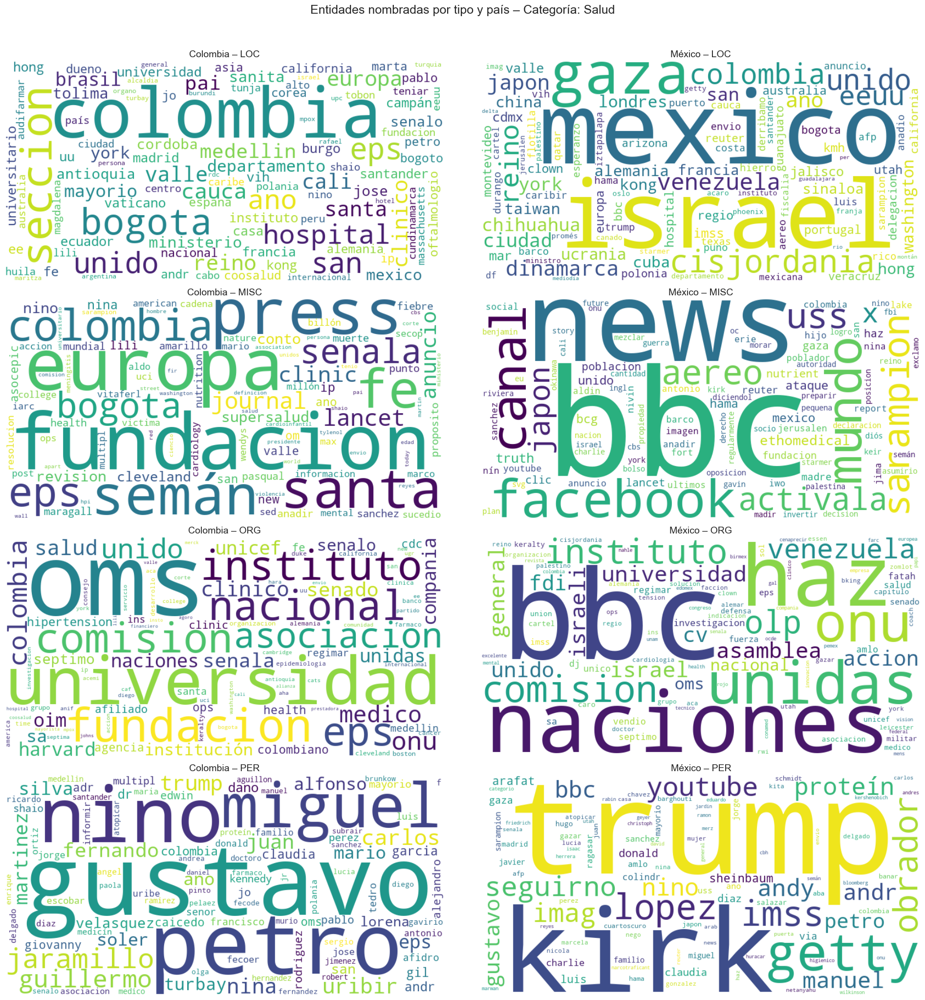

=== SEGURIDAD ===


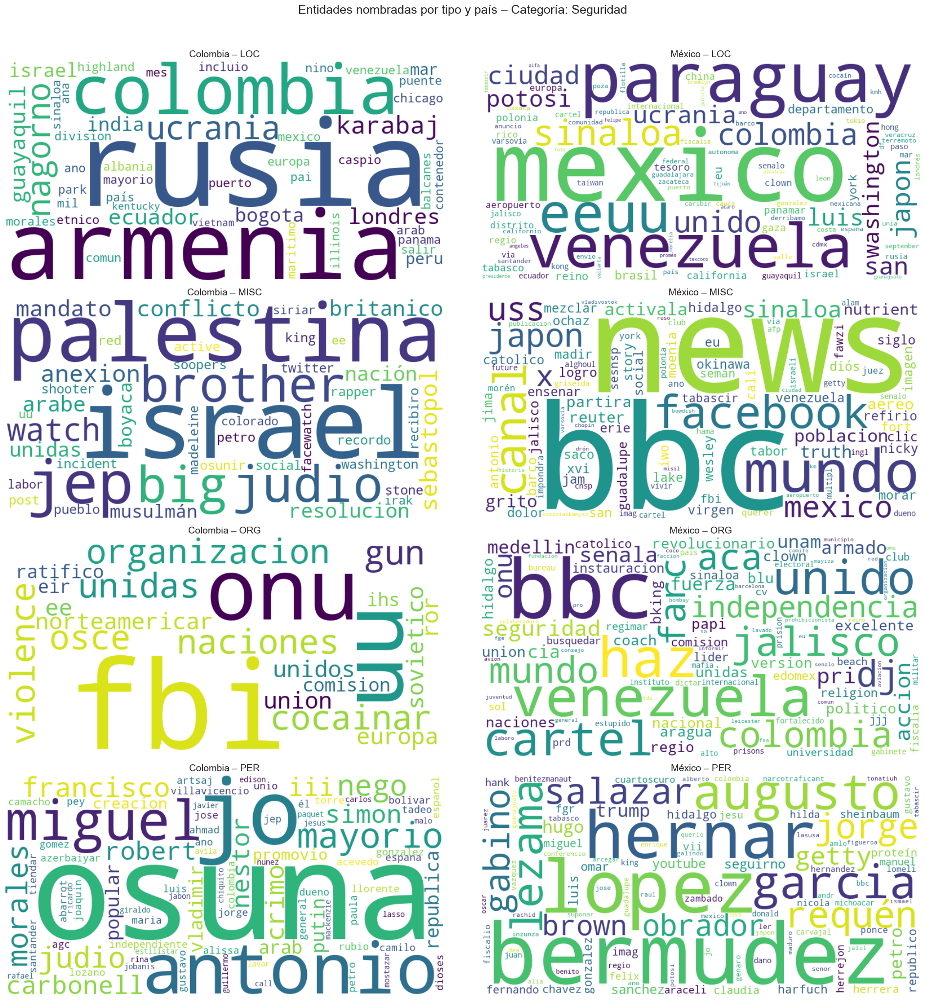

=== ECONOMICA ===


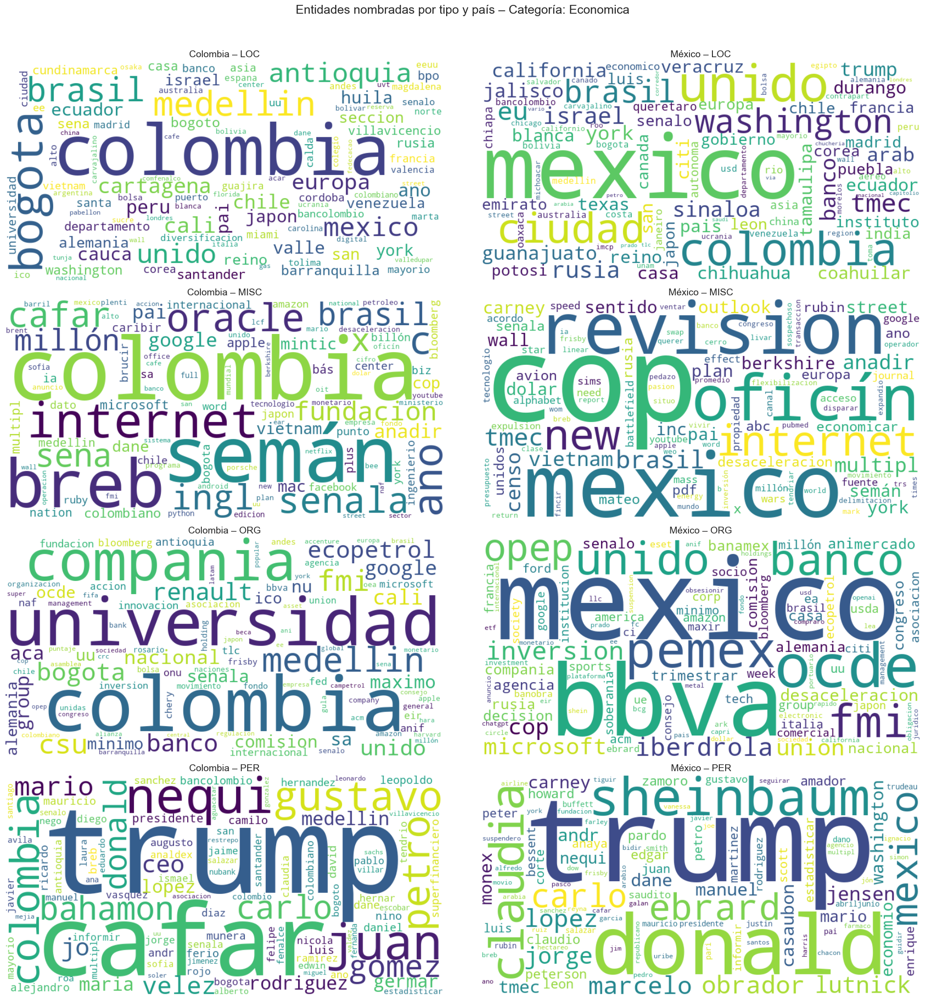

=== CULTURA ===


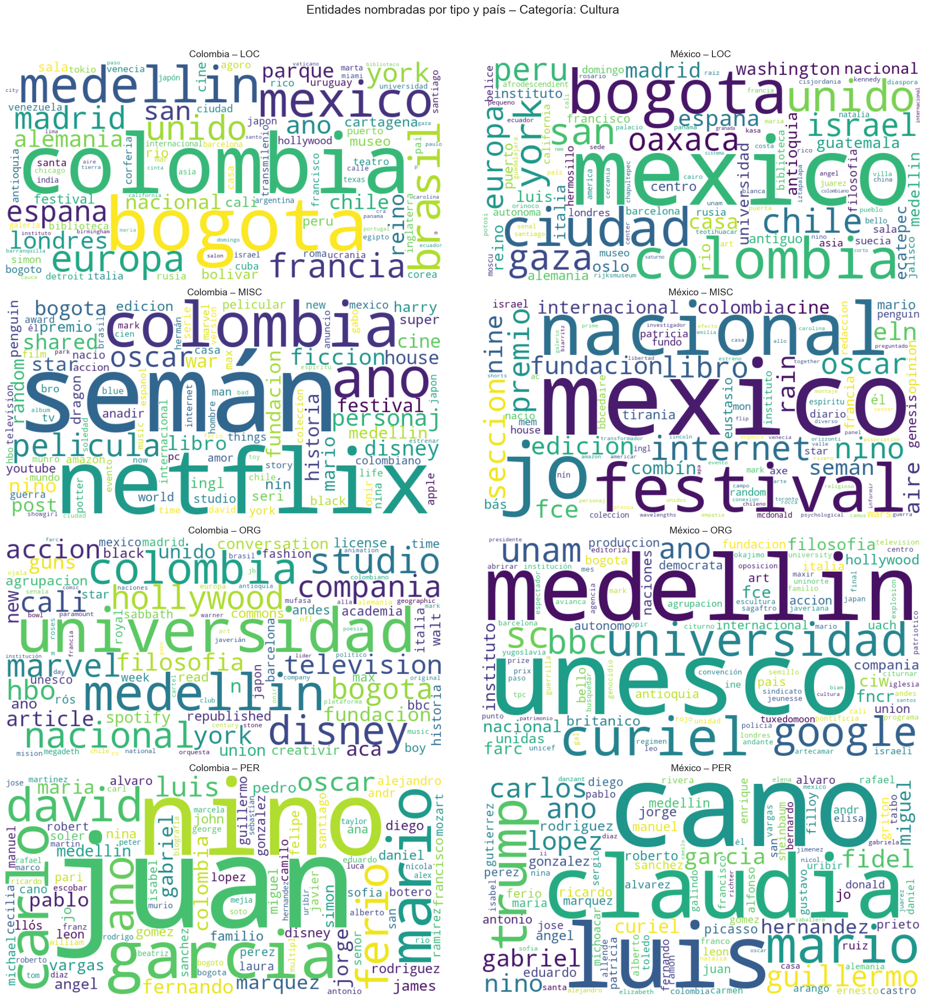

=== JUDICIAL ===


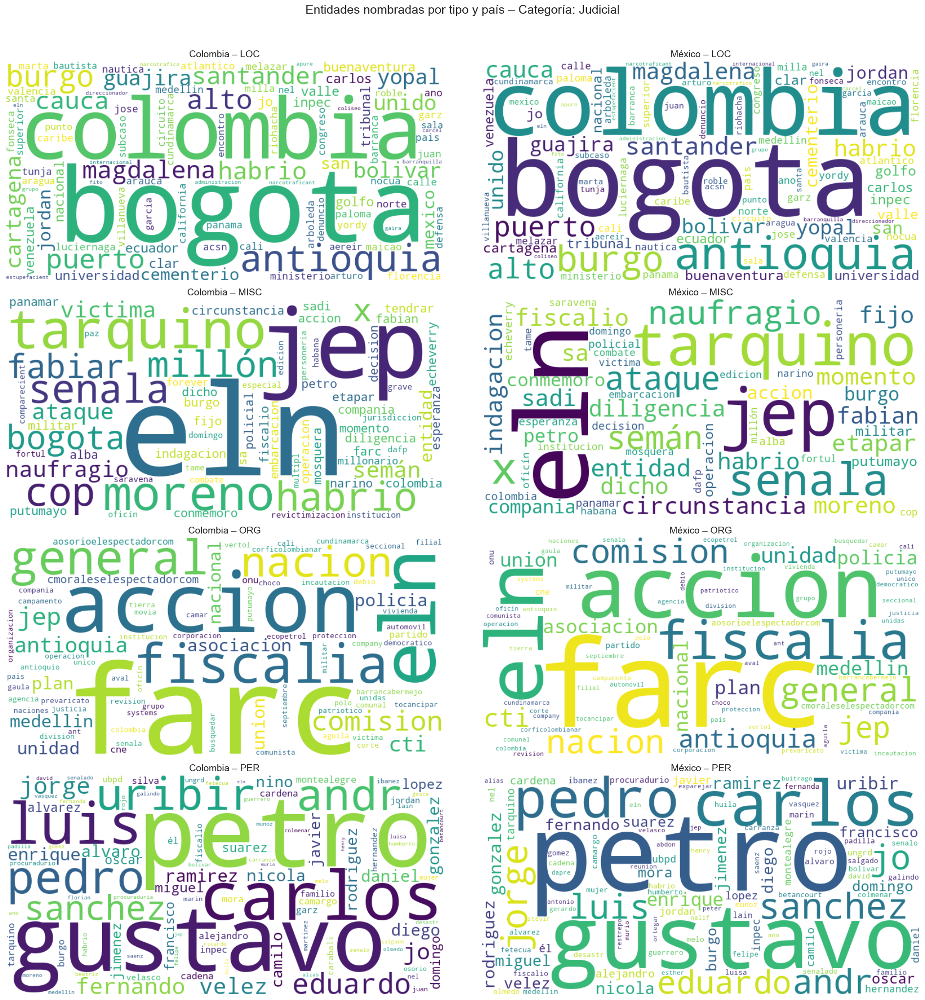

In [47]:
countries = ["Colombia", "México"]
entity_types = sorted(
    set(
        ent[1]
        for ents in df["entities"].dropna().explode()
        if isinstance(ents, tuple)
        for ent in [ents]
    )
)

# Loop over categories
for category in df["category"].unique():
    print(f"=== {category.upper()} ===")

    # One row per entity type, two columns (Colombia vs Mexico)
    fig, axes = plt.subplots(len(entity_types), 2, figsize=(20, 5 * len(entity_types)))

    if len(entity_types) == 1:
        axes = [axes]  # handle case of single entity type

    for i, entity_type in enumerate(entity_types):
        for j, country in enumerate(countries):
            ax = axes[i][j]

            subset = df[(df["country"] == country) & (df["category"] == category)]
            entities_texts = subset["entities"].explode().dropna()
            entities_texts = [ent[0] for ent in entities_texts if isinstance(ent, tuple) and ent[1] == entity_type]

            if len(entities_texts) == 0:
                ax.set_title(f"{country} – {entity_type}: sin datos", fontsize=12)
                ax.axis("off")
                continue

            # Generate WordCloud
            text = " ".join(entities_texts)
            wc = WordCloud(
                width=800, height=400,
                background_color="white",
                max_words=100,
                collocations=False
            ).generate(text)

            ax.imshow(wc, interpolation="bilinear")
            ax.axis("off")
            ax.set_title(f"{country} – {entity_type}", fontsize=14)

    fig.suptitle(f"Entidades nombradas por tipo y país – Categoría: {category}", fontsize=18, y=1.02)
    plt.tight_layout()
    plt.show()

#### Paso 3.3.2: ¿Qué entidades son exclusivas de cada país o comparten ambos?

In [48]:
# Aseguramos que 'entities' tenga formato [(texto, tipo), ...]
df_entities = df.explode("entities").dropna(subset=["entities"])
df_entities["entity_text"] = df_entities["entities"].apply(lambda x: x[0] if isinstance(x, tuple) else None)
df_entities["entity_type"] = df_entities["entities"].apply(lambda x: x[1] if isinstance(x, tuple) else None)

# Agrupamos entidades por país y tipo
entities_by_country = (
    df_entities.groupby(["country", "entity_type"])["entity_text"]
    .apply(lambda x: set(map(str.lower, x.dropna())))
    .reset_index()
)

# Unimos Colombia y México por tipo de entidad
merged = entities_by_country.pivot(index="entity_type", columns="country", values="entity_text")

# Reemplazamos NaN con conjuntos vacíos
merged = merged.applymap(lambda x: x if isinstance(x, set) else set())

# Calculamos exclusivas y compartidas
results = []
for entity_type, row in merged.iterrows():
    colombia_ents = row.get("Colombia", set())
    mexico_ents = row.get("México", set())

    exclusivas_col = colombia_ents - mexico_ents
    exclusivas_mex = mexico_ents - colombia_ents
    compartidas = colombia_ents & mexico_ents

    results.append({
        "entity_type": entity_type,
        "exclusivas_colombia": list(exclusivas_col)[:15],  # top 15
        "exclusivas_mexico": list(exclusivas_mex)[:15],
        "compartidas": list(compartidas)[:15]
    })

exclusive_df = pd.DataFrame(results)
exclusive_df

C:\Users\guill\AppData\Local\Temp\ipykernel_59120\3689353077.py:17: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  merged = merged.applymap(lambda x: x if isinstance(x, set) else set())


,entity_type,exclusivas_colombia,exclusivas_mexico,compartidas
0,LOC,"[fenomeno nino, santa barbara, novgorod, ibaga...","[mexico mexico responderar, bebes, san diego c...","[mediacion egipto, urgio, brasilén, teatro sca..."
1,MISC,"[boeing poseidon, blue ivy carter, registrir, ...","[iran b hama c, embajadoro mexico chile alicia...","[uss lake erie, fiscalio momento, cop millón, ..."
2,ORG,"[bogota fashion week internacionalizacion, uni...","[movimiento politico unido, partido verde jose...","[dfs, unia solidaridad internacional defensa d..."
3,PER,"[gabriel enrique castilla castillo, camilo orb...","[gilberto batiz claudia valle aguilasocho, qui...","[dea, lena, francoargelín helenir, polvoro bar..."


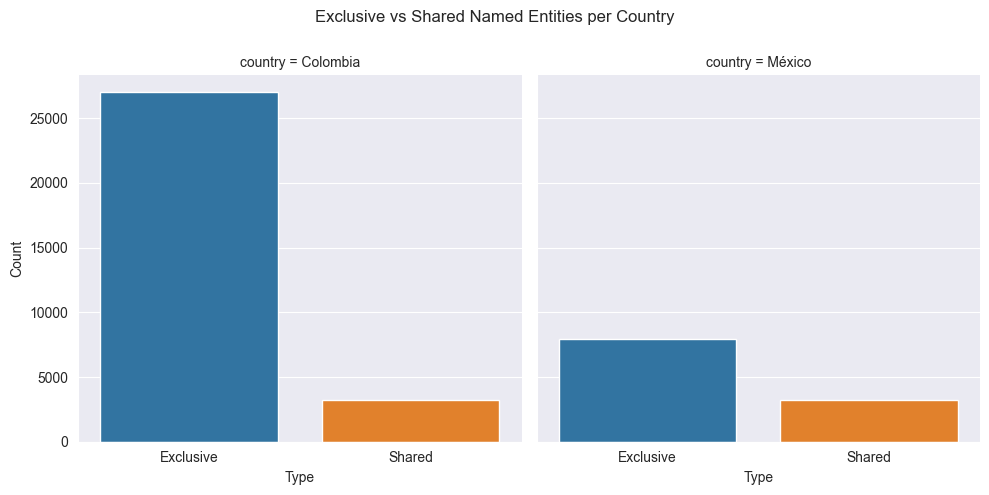

In [49]:
# Compute exclusive/shared entities per country
col_entities = set(
    ent[0].lower() for ent in df[df["country"]=="Colombia"]["entities"].explode()
    if isinstance(ent, tuple)
)
mex_entities = set(
    ent[0].lower() for ent in df[df["country"]=="México"]["entities"].explode()
    if isinstance(ent, tuple)
)

# Prepare DataFrame
plot_df = pd.DataFrame([
    {"country": "Colombia", "Type": "Exclusive", "Count": len(col_entities - mex_entities)},
    {"country": "Colombia", "Type": "Shared", "Count": len(col_entities & mex_entities)},
    {"country": "México", "Type": "Exclusive", "Count": len(mex_entities - col_entities)},
    {"country": "México", "Type": "Shared", "Count": len(col_entities & mex_entities)}
])

# Plot
sns.catplot(
    data=plot_df,
    x="Type", y="Count",
    hue="Type", col="country",
    kind="bar", dodge=False,
    height=5, sharey=True
)
plt.subplots_adjust(top=0.85)
plt.suptitle("Exclusive vs Shared Named Entities per Country")
plt.show()


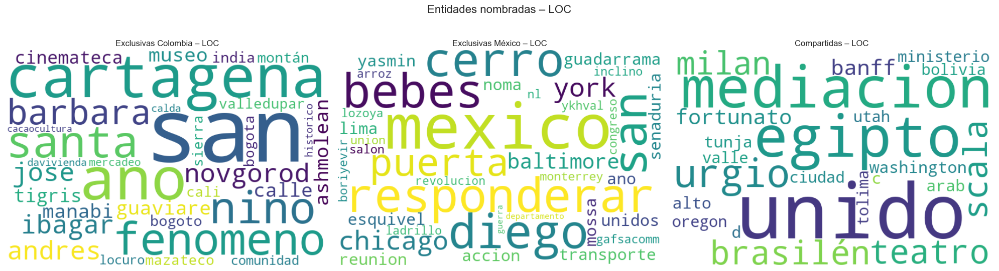

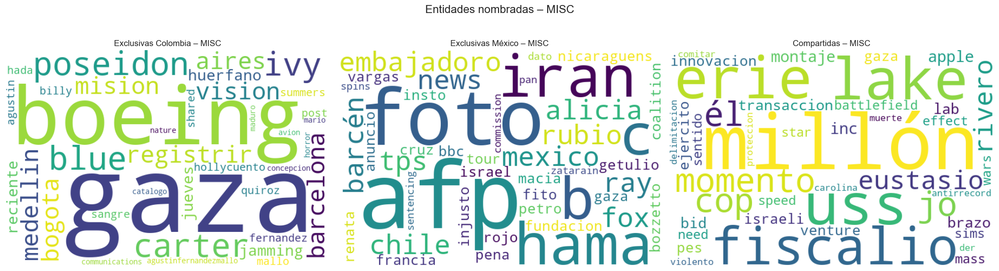

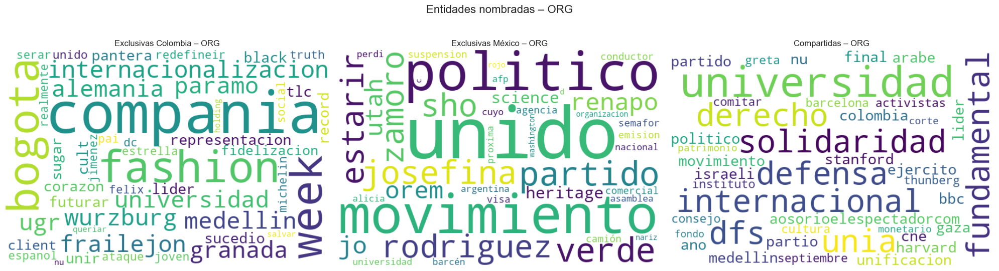

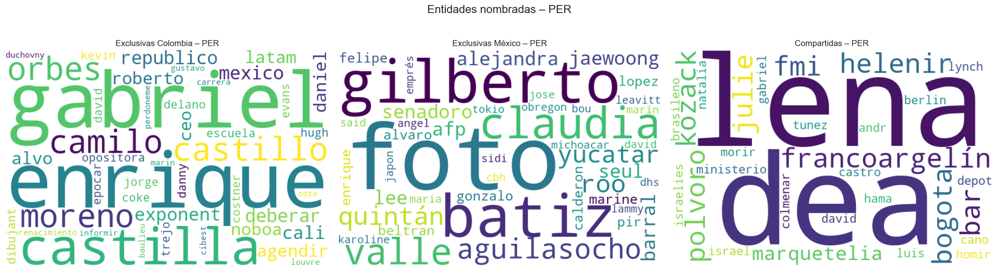

In [50]:
# Loop over each entity type
for idx, row in exclusive_df.iterrows():
    entity_type = row["entity_type"]
    colombia_text = " ".join(row["exclusivas_colombia"])
    mexico_text = " ".join(row["exclusivas_mexico"])
    shared_text = " ".join(row["compartidas"])

    # Create a figure with 3 subplots
    fig, axes = plt.subplots(1, 3, figsize=(20, 6))

    # Colombia exclusive
    wc_col = WordCloud(width=600, height=400, background_color="white").generate(colombia_text)
    axes[0].imshow(wc_col, interpolation="bilinear")
    axes[0].axis("off")
    axes[0].set_title(f"Exclusivas Colombia – {entity_type}")

    # Mexico exclusive
    wc_mex = WordCloud(width=600, height=400, background_color="white").generate(mexico_text)
    axes[1].imshow(wc_mex, interpolation="bilinear")
    axes[1].axis("off")
    axes[1].set_title(f"Exclusivas México – {entity_type}")

    # Shared
    wc_shared = WordCloud(width=600, height=400, background_color="white").generate(shared_text)
    axes[2].imshow(wc_shared, interpolation="bilinear")
    axes[2].axis("off")
    axes[2].set_title(f"Compartidas – {entity_type}")

    plt.suptitle(f"Entidades nombradas – {entity_type}", fontsize=16)
    plt.tight_layout()
    plt.show()

In [51]:
# Extract sets of entities per country
entities_col = set([ent[0] for ents in df[df["country"]=="Colombia"]["entities"] if isinstance(ents, list) for ent in ents])
entities_mex = set([ent[0] for ents in df[df["country"]=="México"]["entities"] if isinstance(ents, list) for ent in ents])

# Entities exclusive to each country
exclusive_col = entities_col - entities_mex
exclusive_mex = entities_mex - entities_col

# Entities shared by both
shared_entities = entities_col & entities_mex

print(f"Exclusive to Colombia: {len(exclusive_col)} entities")
print(f"Exclusive to México: {len(exclusive_mex)} entities")
print(f"Shared: {len(shared_entities)} entities")



Exclusive to Colombia: 26984 entities
Exclusive to México: 7936 entities
Shared: 3250 entities


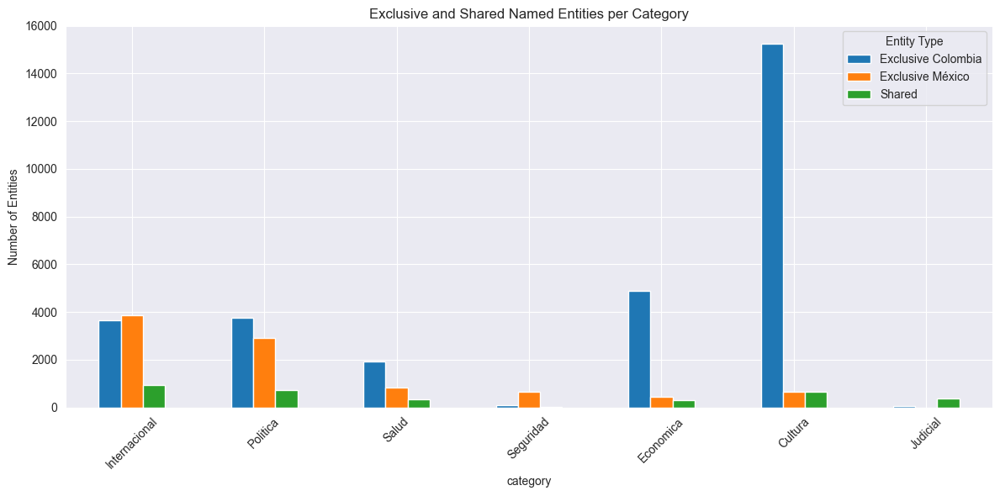

In [52]:
# Prepare a DataFrame to store counts
rows = []

for category in df["category"].unique():
    col_entities = set(
        [ent[0] for ent in df[(df["country"]=="Colombia") & (df["category"]==category)]["entities"].explode()
         if isinstance(ent, tuple)]
    )
    mex_entities = set(
        [ent[0] for ent in df[(df["country"]=="México") & (df["category"]==category)]["entities"].explode()
         if isinstance(ent, tuple)]
    )
    exclusive_col = col_entities - mex_entities
    exclusive_mex = mex_entities - col_entities
    shared = col_entities & mex_entities

    rows.append({
        "category": category,
        "Exclusive Colombia": len(exclusive_col),
        "Exclusive México": len(exclusive_mex),
        "Shared": len(shared)
    })

plot_df = pd.DataFrame(rows)

# Plot
plot_df.set_index("category").plot(kind="bar", figsize=(12,6))
plt.ylabel("Number of Entities")
plt.title("Exclusive and Shared Named Entities per Category")
plt.xticks(rotation=45)
plt.legend(title="Entity Type")
plt.tight_layout()
plt.show()

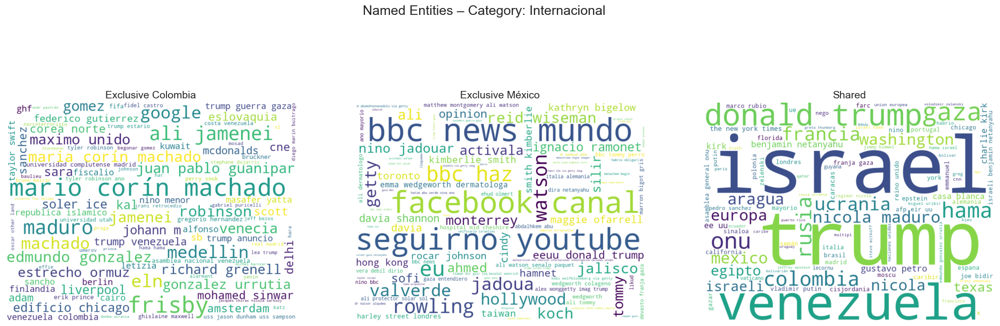

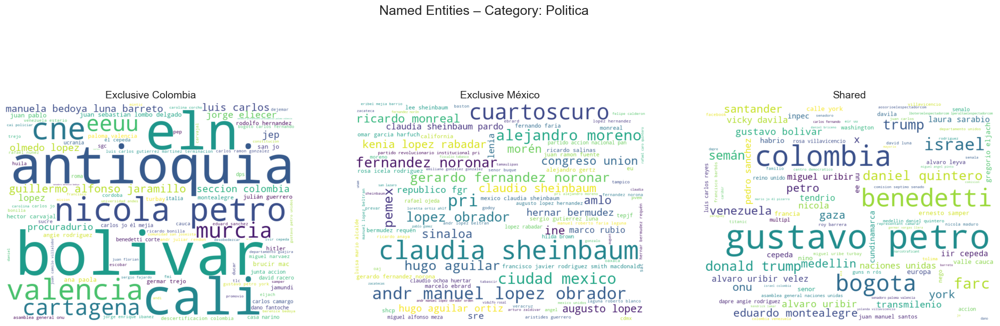

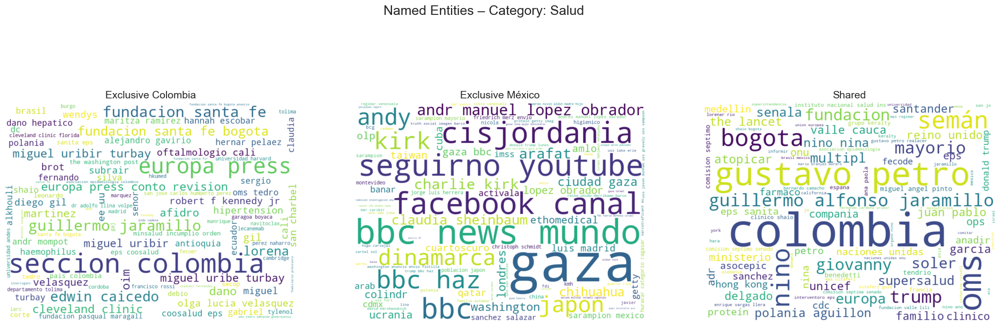

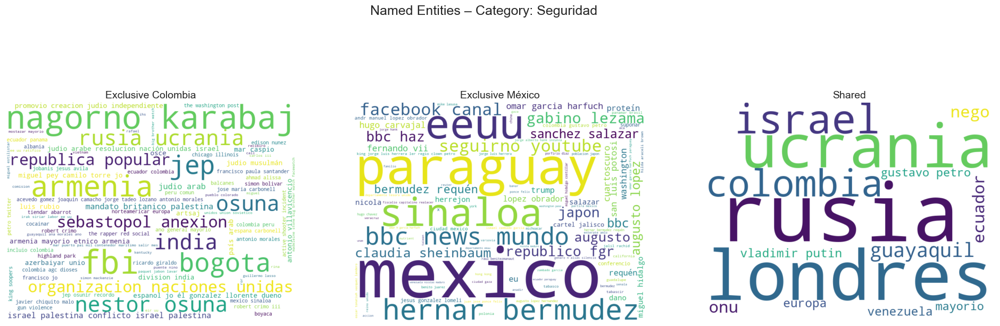

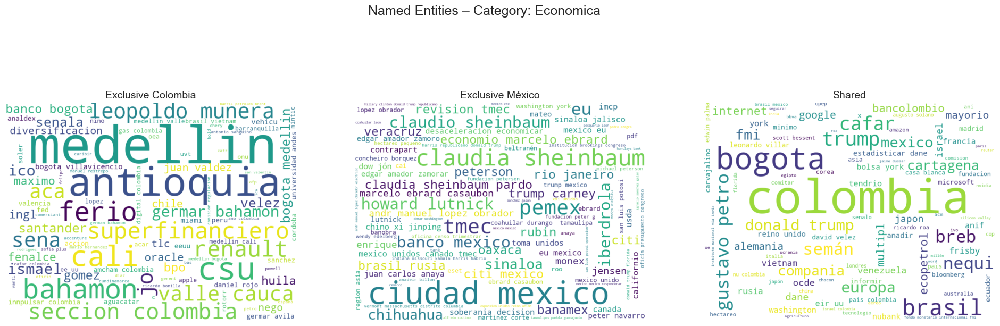

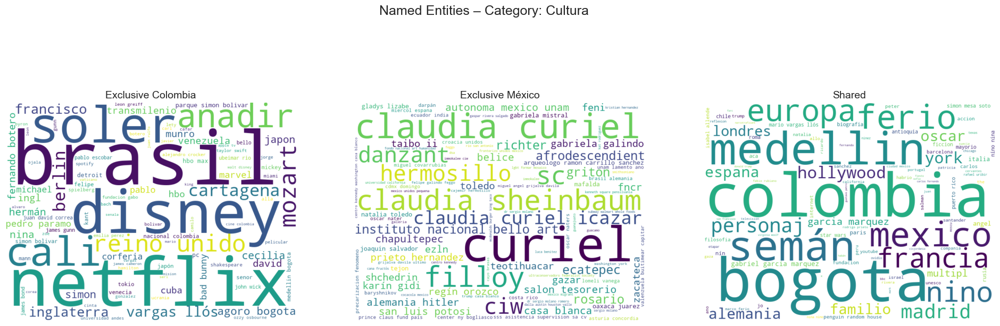

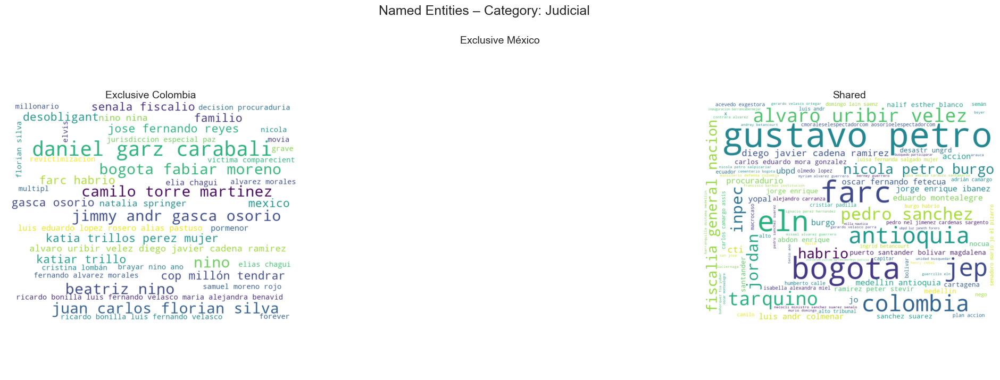

In [53]:
for category in df["category"].unique():
    # Get all entities per country
    col_entities = [ent[0] for ent in df[(df["country"]=="Colombia") & (df["category"]==category)]["entities"].explode()
                    if isinstance(ent, tuple)]
    mex_entities = [ent[0] for ent in df[(df["country"]=="México") & (df["category"]==category)]["entities"].explode()
                    if isinstance(ent, tuple)]

    # Count frequencies
    col_counter = Counter(col_entities)
    mex_counter = Counter(mex_entities)

    # Exclusive and shared entities with frequencies
    exclusive_col = {k:v for k,v in col_counter.items() if k not in mex_counter}
    exclusive_mex = {k:v for k,v in mex_counter.items() if k not in col_counter}
    shared = {k:v for k,v in col_counter.items() if k in mex_counter}

    # Create figure
    fig, axes = plt.subplots(1, 3, figsize=(24,8))
    fig.suptitle(f"Named Entities – Category: {category}", fontsize=18)

    # Word clouds
    for ax, data, title in zip(axes, [exclusive_col, exclusive_mex, shared],
                               ["Exclusive Colombia", "Exclusive México", "Shared"]):
        if data:  # Only generate if there is data
            wc = WordCloud(width=800, height=600, background_color="white", max_words=100, collocations=False)
            wc.generate_from_frequencies(data)
            ax.imshow(wc, interpolation="bilinear")
        ax.axis("off")
        ax.set_title(title, fontsize=14)

    plt.show()

#### Paso 3.3.3: ¿Qué temas predominan?

C:\Users\guill\AppData\Local\Temp\ipykernel_59120\719633996.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


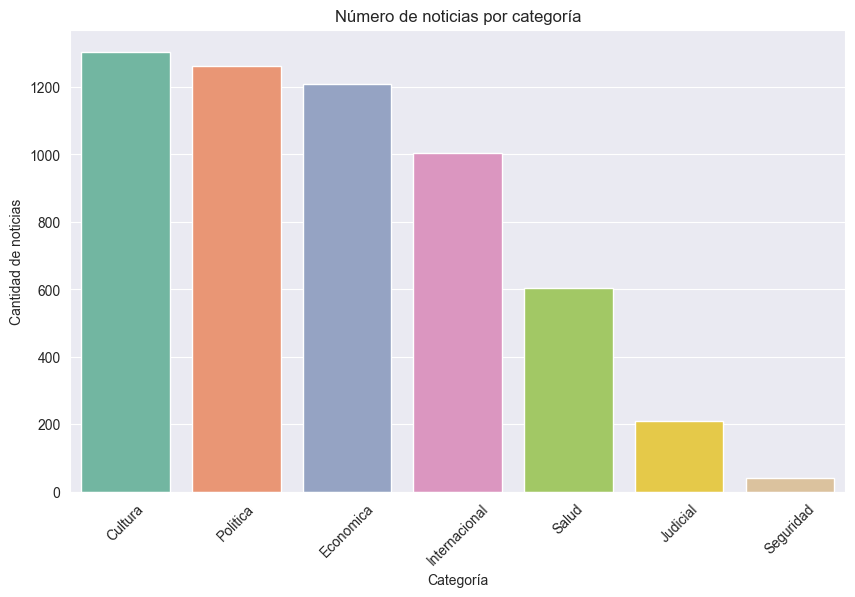

In [54]:
# Count texts per category
category_counts = df["category"].value_counts().reset_index()
category_counts.columns = ["category", "count"]

# Plot
plt.figure(figsize=(10,6))
sns.barplot(
    data=category_counts.sort_values("count", ascending=False),
    x="category",
    y="count",
    palette="Set2"
)
plt.title("Número de noticias por categoría")
plt.xlabel("Categoría")
plt.ylabel("Cantidad de noticias")
plt.xticks(rotation=45)
plt.show()

#### Paso 3.3.4: ¿Cómo varía la densidad de entidades por categoria o medio?

In [55]:
# Ensure content_tokens are lists of words
df["content_tokens"] = df["content_tokens"].apply(lambda x: x.split() if isinstance(x, str) else [])

# Ensure entities column is a list
df["entities"] = df["entities"].apply(lambda x: x if isinstance(x, list) else [])

# Compute number of entities and tokens
df["num_entities"] = df["entities"].apply(len)
df["num_tokens"] = df["content_tokens"].apply(len)

In [56]:
# Compute entity density safely
df["entity_density"] = df.apply(
    lambda row: row["num_entities"] / row["num_tokens"] if row["num_tokens"] > 0 else 0, axis=1
)

# Quick check
df[["num_entities", "num_tokens", "entity_density"]].head()

,num_entities,num_tokens,entity_density
0,78,988,0.078947
1,89,1549,0.057456
2,154,1342,0.114754
3,113,1292,0.087461
4,52,510,0.101961


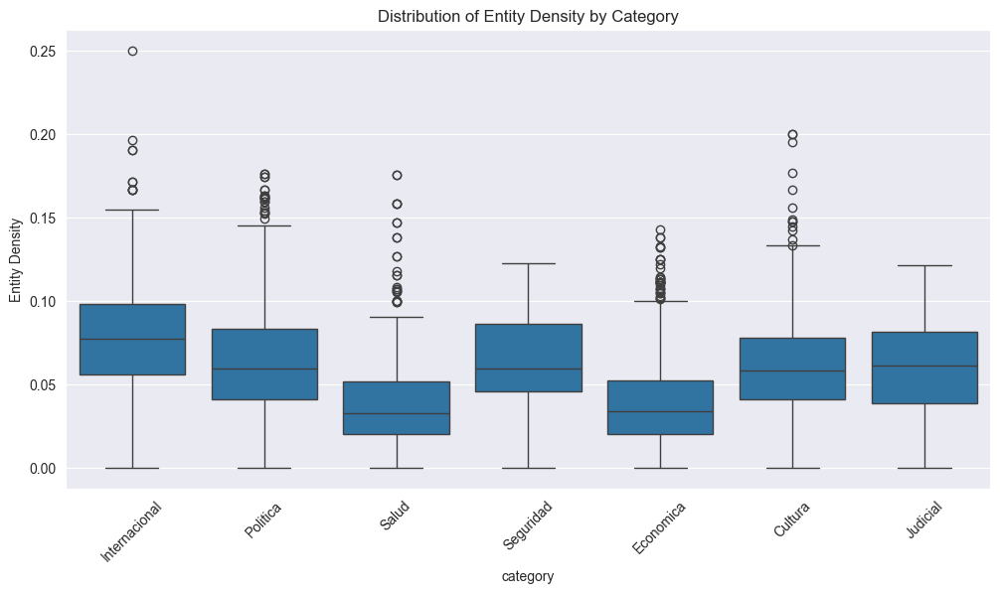

In [57]:
plt.figure(figsize=(12,6))
sns.boxplot(data=df, x="category", y="entity_density")
plt.ylabel("Entity Density")
plt.xticks(rotation=45)
plt.title("Distribution of Entity Density by Category")
plt.show()


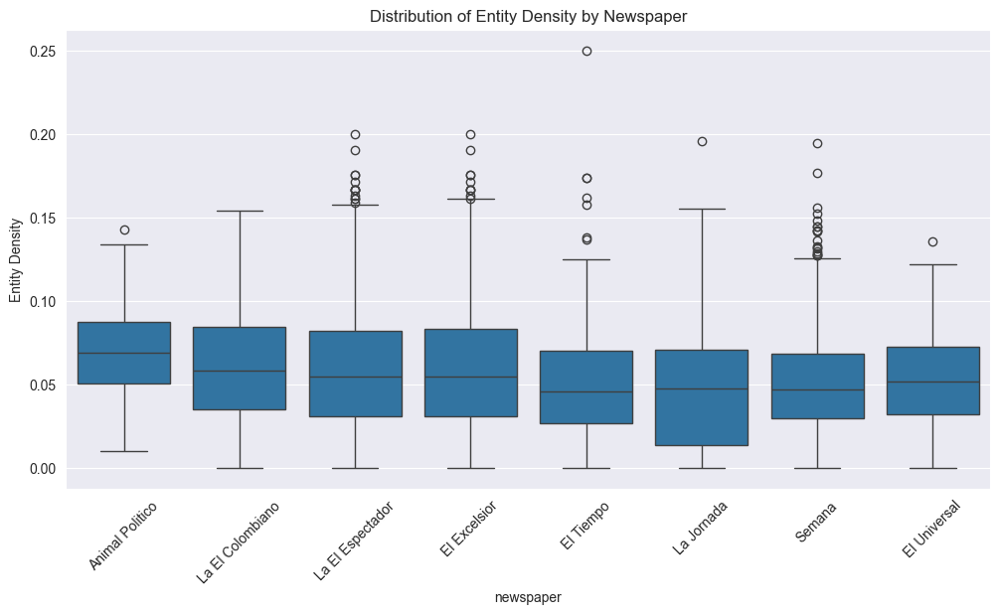

In [58]:
plt.figure(figsize=(12,6))
sns.boxplot(data=df, x="newspaper", y="entity_density")
plt.ylabel("Entity Density")
plt.xticks(rotation=45)
plt.title("Distribution of Entity Density by Newspaper")
plt.show()

#### Paso 3.3.5: ¿Qué entidades se asocian a los temas más recurrentes (por ejemplo, “ONU” con “Relaciones Internacionales”)?

In [59]:
# Make sure entities column is a list of tuples
df["entities"] = df["entities"].apply(lambda x: x if isinstance(x, list) else [])

# Extract only the entity text
df["entity_texts"] = df["entities"].apply(lambda ents: [e[0] for e in ents if isinstance(e, tuple)])

In [60]:
df_exploded = df.explode("entity_texts").dropna(subset=["entity_texts"])

In [61]:
entity_topic_freq = (
    df_exploded.groupby(["category", "entity_texts"])
    .size()
    .reset_index(name="frequency")
    .sort_values(["category", "frequency"], ascending=[True, False])
)

In [62]:
entity_topic_freq = (
    df_exploded.groupby(["category", "entity_texts"])
    .size()
    .reset_index(name="frequency")
    .sort_values(["category", "frequency"], ascending=[True, False])
)

In [63]:
top_entities_per_category = (
    entity_topic_freq.groupby("category")
    .head(10)  # top 10 entities per category
)
top_entities_per_category


,category,entity_texts,frequency
1890,Cultura,bogota,457
3271,Cultura,colombia,451
10157,Cultura,medellin,225
13940,Cultura,semán,199
10365,Cultura,mexico,192
...,...,...,...
41823,Seguridad,hernar bermudez,21
41597,Seguridad,bbc news mundo,18
41745,Seguridad,facebook canal,18
42146,Seguridad,seguirno youtube,18


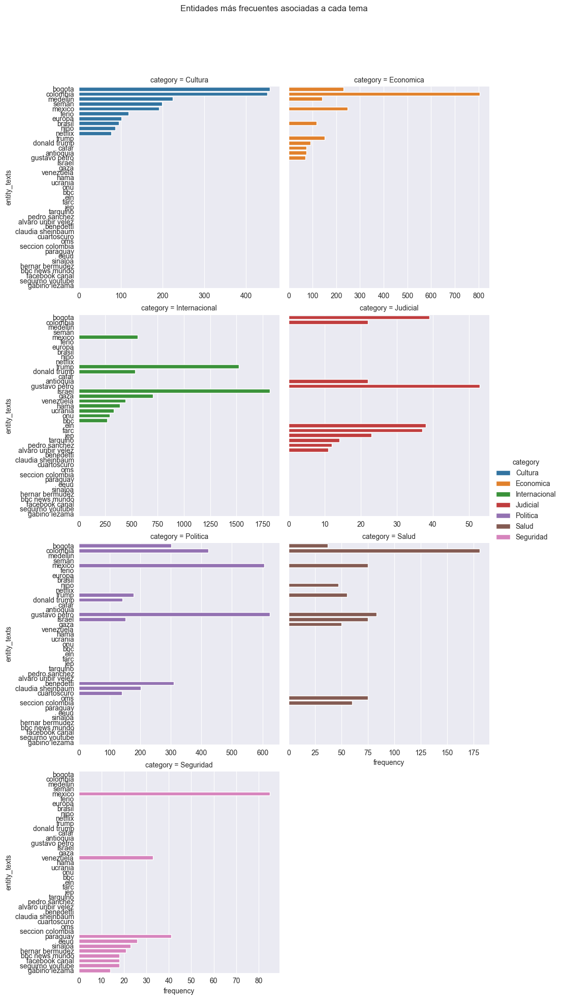

In [64]:
import seaborn as sns
import matplotlib.pyplot as plt

g = sns.catplot(
    data=top_entities_per_category,
    x="frequency",
    y="entity_texts",
    hue="category",
    kind="bar",
    col="category",
    col_wrap=2,
    dodge=False,
    sharex=False,
    height=5
)

plt.subplots_adjust(top=0.9)
plt.suptitle("Entidades más frecuentes asociadas a cada tema")
plt.show()

### Paso 3.4: Análisis morfosintáctico y de estilo

Propósito: Detectar diferencias en el estilo periodístico y la estructura gramatical que podrían influir en el tipo de preguntas o respuestas que se pueden generar.

#### Paso 3.4.1: ¿Qué categorías gramaticales (sustantivos, verbos, adjetivos, etc.) predominan en cada país o sección?

In [65]:
def get_pos_tags(text):
    """
    Input: string
    Output: list of POS tags
    """
    doc = nlp(text)
    return [token.pos_ for token in doc]


In [66]:
# Create a new column with POS tags
df["pos_tags"] = df["content"].apply(lambda x: get_pos_tags(x) if isinstance(x, str) else [])

In [67]:
df_pos = df.explode("pos_tags").dropna(subset=["pos_tags"])

In [68]:
pos_counts = (
    df_pos.groupby(["country", "category", "pos_tags"])
    .size()
    .reset_index(name="count")
    .sort_values(["country", "category", "count"], ascending=[True, True, False])
)
pos_counts.head(20)

,country,category,pos_tags,count
7,Colombia,Cultura,NOUN,190251
1,Colombia,Cultura,ADP,146372
5,Colombia,Cultura,DET,132418
12,Colombia,Cultura,PUNCT,131508
16,Colombia,Cultura,VERB,90159
11,Colombia,Cultura,PROPN,82324
0,Colombia,Cultura,ADJ,68211
10,Colombia,Cultura,PRON,57616
4,Colombia,Cultura,CCONJ,36297
2,Colombia,Cultura,ADV,34045


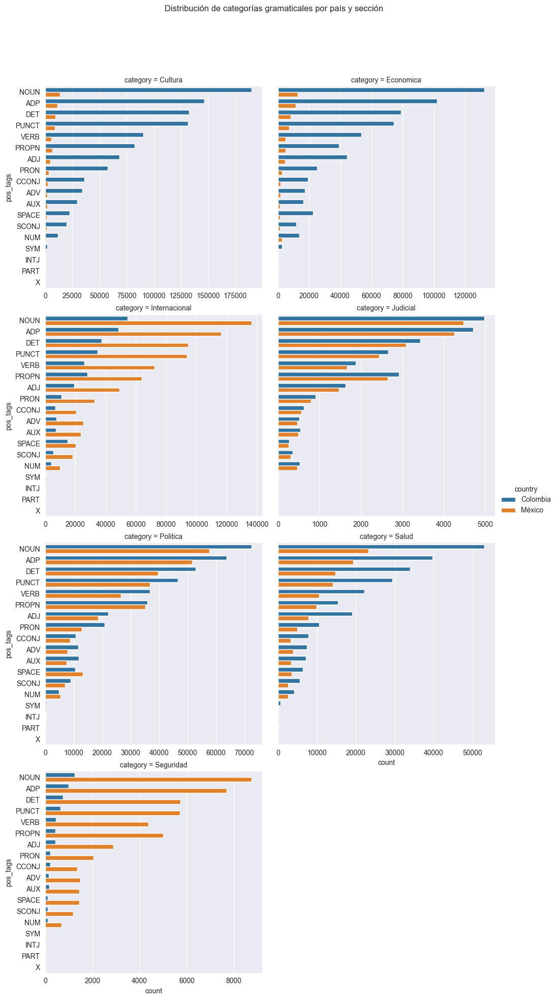

In [69]:
import seaborn as sns
import matplotlib.pyplot as plt

# Example: POS distribution per country
g = sns.catplot(
    data=pos_counts,
    x="count",
    y="pos_tags",
    hue="country",
    col="category",  # optional, to separate by section
    kind="bar",
    col_wrap=2,
    sharex=False,
    height=5,
    dodge=True
)

plt.subplots_adjust(top=0.9)
plt.suptitle("Distribución de categorías gramaticales por país y sección")
plt.show()

#### Paso 3.4.2: ¿Qué tan diversa es la estructura léxica entre secciones (índices de diversidad léxica o entropía)?

In [70]:
# If content_tokens are already tokenized
def lexical_diversity(tokens):
    if len(tokens) == 0:
        return 0
    return len(set(tokens)) / len(tokens)

# Apply per text
df["lexical_diversity"] = df["content_tokens"].apply(lambda x: lexical_diversity(x) if isinstance(x, list) else 0)


In [71]:
lex_div_by_category = (
    df.groupby("category")["lexical_diversity"]
    .mean()
    .sort_values(ascending=False)
    .reset_index()
)
lex_div_by_category


,category,lexical_diversity
0,Judicial,0.792341
1,Salud,0.758182
2,Cultura,0.754181
3,Economica,0.743021
4,Politica,0.733451
5,Internacional,0.727534
6,Seguridad,0.697251


In [72]:
def shannon_entropy(tokens):
    if not tokens:
        return 0
    counts = np.array(list(Counter(tokens).values()))
    probs = counts / counts.sum()
    return -(probs * np.log2(probs)).sum()

# Apply per text
df["entropy"] = df["content_tokens"].apply(lambda x: shannon_entropy(x) if isinstance(x, list) else 0)

In [73]:
entropy_by_category = (
    df.groupby("category")["entropy"]
    .mean()
    .sort_values(ascending=False)
    .reset_index()
)
entropy_by_category


,category,entropy
0,Seguridad,7.742374
1,Cultura,7.273735
2,Internacional,7.209182
3,Economica,6.891542
4,Salud,6.728106
5,Politica,6.705495
6,Judicial,5.979230


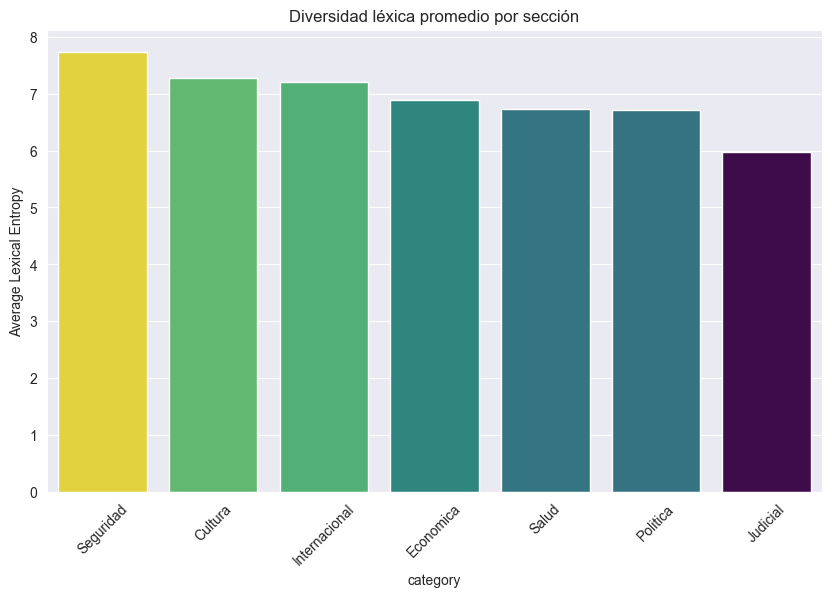

In [74]:
plt.figure(figsize=(10,6))
sns.barplot(data=entropy_by_category, x="category", y="entropy", hue="entropy", palette="viridis", legend=False)
plt.xticks(rotation=45)
plt.ylabel("Average Lexical Entropy")
plt.title("Diversidad léxica promedio por sección")
plt.show()

#### Paso 3.4.3: ¿Existen patrones de estilo o formalidad distintos por tipo de periódico o país?

In [78]:
# Longitud promedio de oraciones
df["avg_sentence_length"] = df["content_sentence_tokenization"].apply(
    lambda sents: np.mean([len(sent.split()) for sent in sents]) if isinstance(sents, list) and len(sents) > 0 else 0
)

# Longitud promedio de palabras
df["avg_word_length"] = df["content_tokens"].apply(
    lambda tokens: np.mean([len(token) for token in tokens]) if isinstance(tokens, list) and len(tokens) > 0 else 0
)


In [79]:
df["flesch_reading_ease"] = df["content_removed_unwanted_elements"].apply(lambda x: textstat.flesch_reading_ease(x) if isinstance(x, str) else 0)

In [80]:
df["lexical_diversity"] = df["content_tokens"].apply(lambda x: len(set(x))/len(x) if len(x) > 0 else 0)

In [81]:
df_grouped = df.groupby(["country", "newspaper"]).agg({
    "flesch_reading_ease": "mean",
    "avg_sentence_length": "mean",
    "lexical_diversity": "mean"
}).reset_index()

C:\Users\guill\AppData\Local\Temp\ipykernel_59120\2938499745.py:5: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45)
C:\Users\guill\AppData\Local\Temp\ipykernel_59120\2938499745.py:9: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45)
C:\Users\guill\AppData\Local\Temp\ipykernel_59120\2938499745.py:13: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[2].set_xticklabels(axes[2].get_xticklabels(), rotation=45)


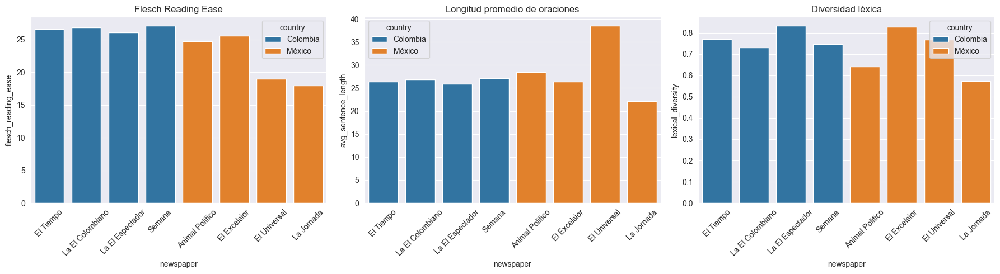

In [82]:
fig, axes = plt.subplots(1, 3, figsize=(18,5))

sns.barplot(data=df_grouped, x="newspaper", y="flesch_reading_ease", hue="country", ax=axes[0])
axes[0].set_title("Flesch Reading Ease")
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45)

sns.barplot(data=df_grouped, x="newspaper", y="avg_sentence_length", hue="country", ax=axes[1])
axes[1].set_title("Longitud promedio de oraciones")
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45)

sns.barplot(data=df_grouped, x="newspaper", y="lexical_diversity", hue="country", ax=axes[2])
axes[2].set_title("Diversidad léxica")
axes[2].set_xticklabels(axes[2].get_xticklabels(), rotation=45)

plt.tight_layout()
plt.show()


## Paso 4: Desarrollar la metodología para generar preguntas y respuestas automáticas

Propósito:
Evaluar la calidad estructural y semántica de los textos para determinar su potencial en la generación automática de preguntas y respuestas.

### Paso 4.1: ¿Qué porcentaje de noticias tiene párrafos con oraciones bien formadas (sin errores o repeticiones)?

In [83]:
def is_well_formed_sentence(sent):
    sent = sent.strip()
    if len(sent) == 0:
        return False

    # Remove leading non-letter characters (quotes, parentheses, etc.)
    first_char = re.sub(r'^[^A-Za-zÁÉÍÓÚÑáéíóúñ]+', '', sent)
    if len(first_char) == 0:
        return False

    # Check if starts with uppercase
    if not first_char[0].isupper():
        return False

    # Check if ends with valid punctuation
    if sent[-1] not in ".!?":
        return False

    # Check repeated words
    words = [unidecode.unidecode(w.lower()) for w in sent.split()]
    for i in range(len(words)-1):
        if words[i] == words[i+1]:
            return False

    return True

In [84]:
def is_well_formed_paragraph(paragraph):
    sentences = re.split(r'(?<=[.!?¿¡]) +', paragraph)
    if len(sentences) == 0:
        return False

    # Paragraph is well-formed if all sentences are well-formed
    return all(is_well_formed_sentence(s) for s in sentences)

In [88]:
# Apply to dataframe
df["well_formed_paragraph"] = df["content_removed_unwanted_elements"].apply(
    lambda x: is_well_formed_paragraph(x) if isinstance(x, str) else False
)

In [89]:
# Compute percentage of well-formed paragraphs
percentage = df["well_formed_paragraph"].mean() * 100
print(f"Porcentaje de noticias con párrafos bien formados: {percentage:.2f}%")

Porcentaje de noticias con párrafos bien formados: 44.67%


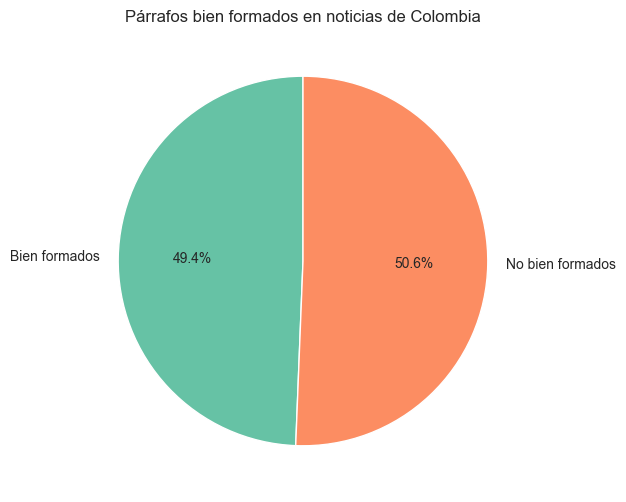

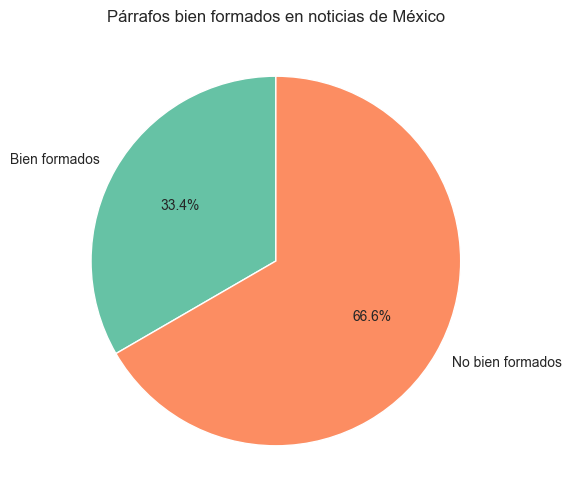

In [93]:
# Compute counts per country
df_grouped = df.groupby("country")["well_formed_paragraph"].mean().reset_index()
df_grouped["well_formed_pct"] = df_grouped["well_formed_paragraph"] * 100
df_grouped["not_well_formed_pct"] = 100 - df_grouped["well_formed_pct"]

for i, row in df_grouped.iterrows():
    labels = ["Bien formados", "No bien formados"]
    sizes = [row["well_formed_pct"], row["not_well_formed_pct"]]

    plt.figure(figsize=(6,6))
    plt.pie(sizes, labels=labels, autopct="%1.1f%%", startangle=90, colors=["#66c2a5","#fc8d62"])
    plt.title(f"Párrafos bien formados en noticias de {row['country']}")
    plt.show()


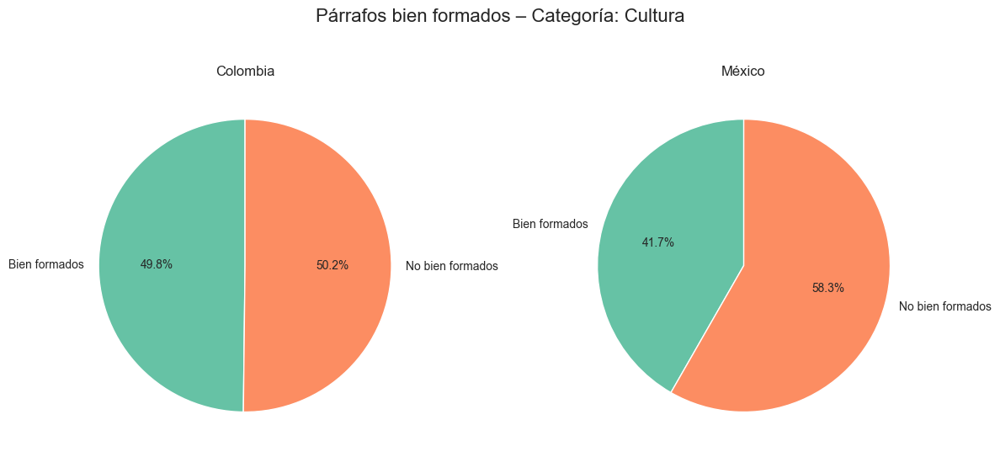

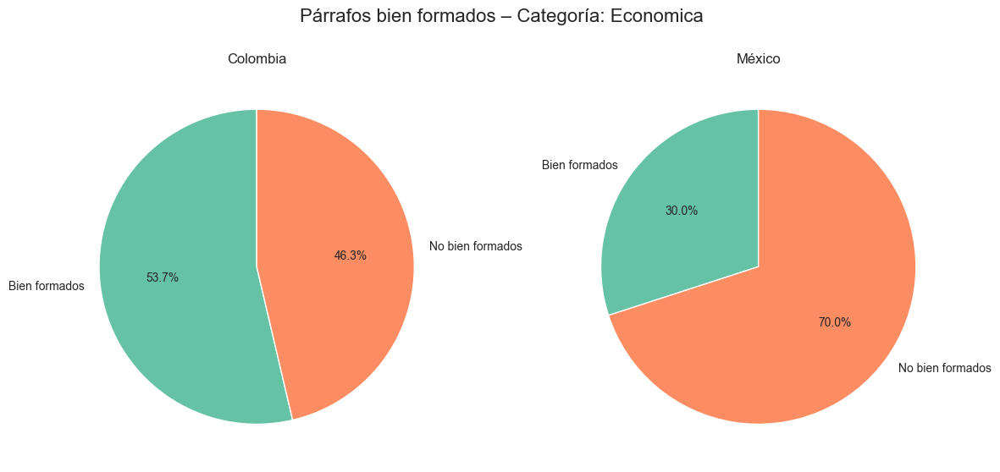

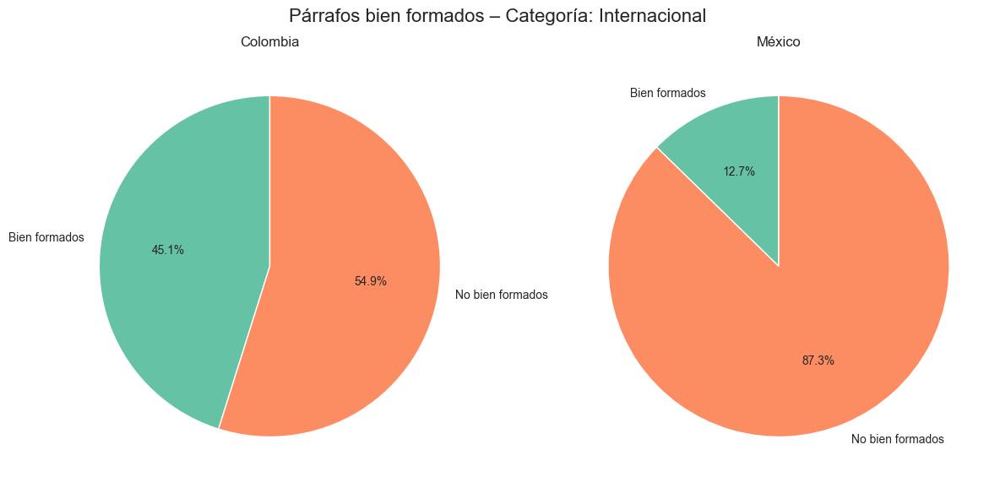

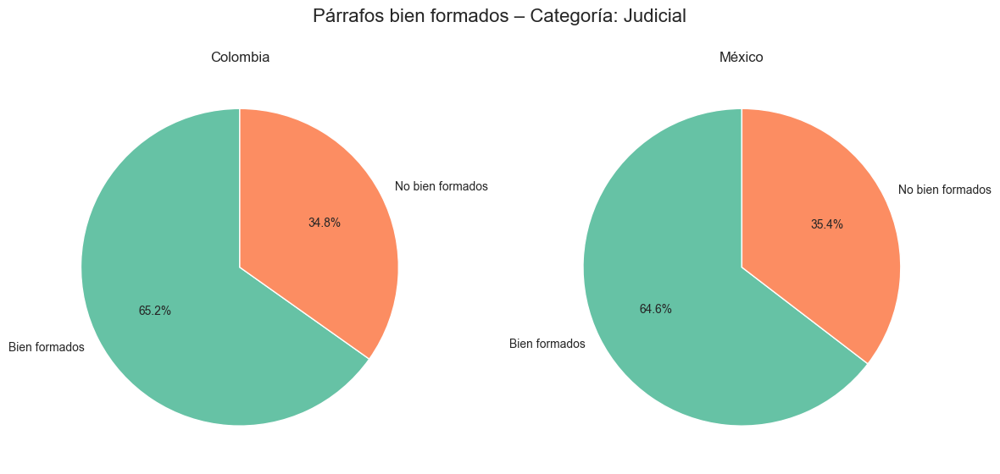

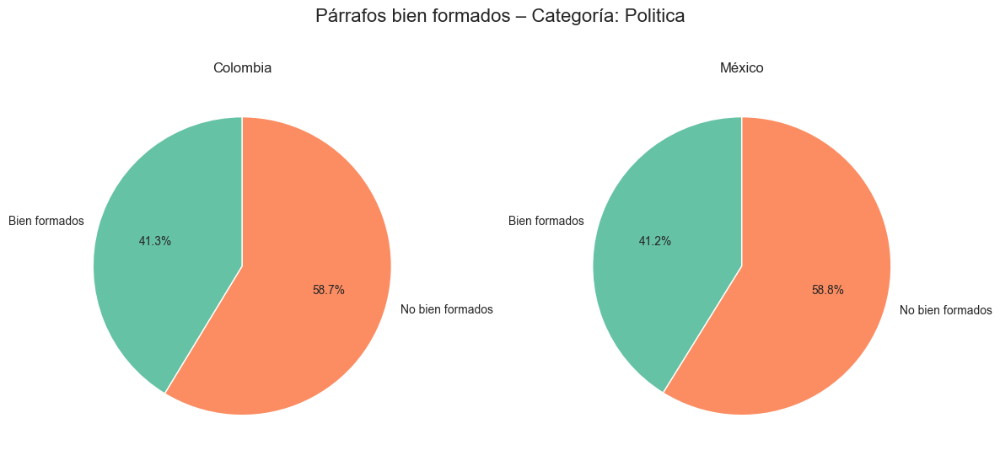

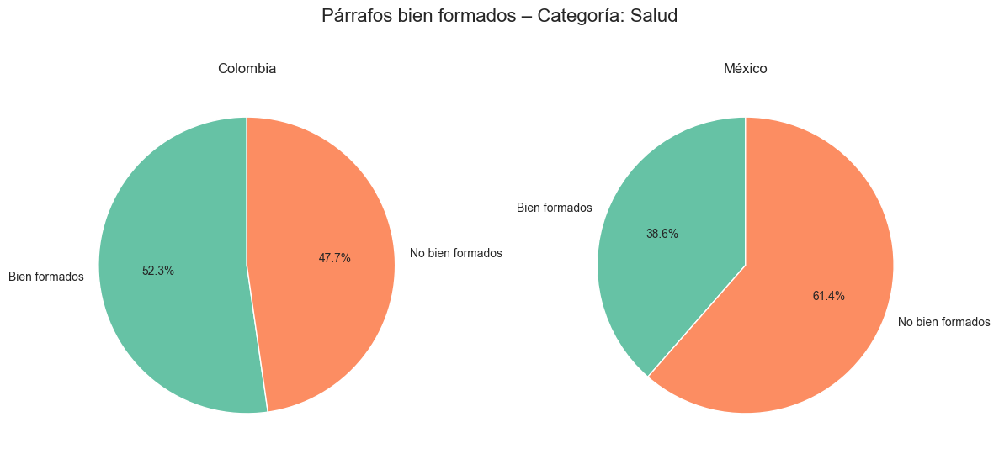

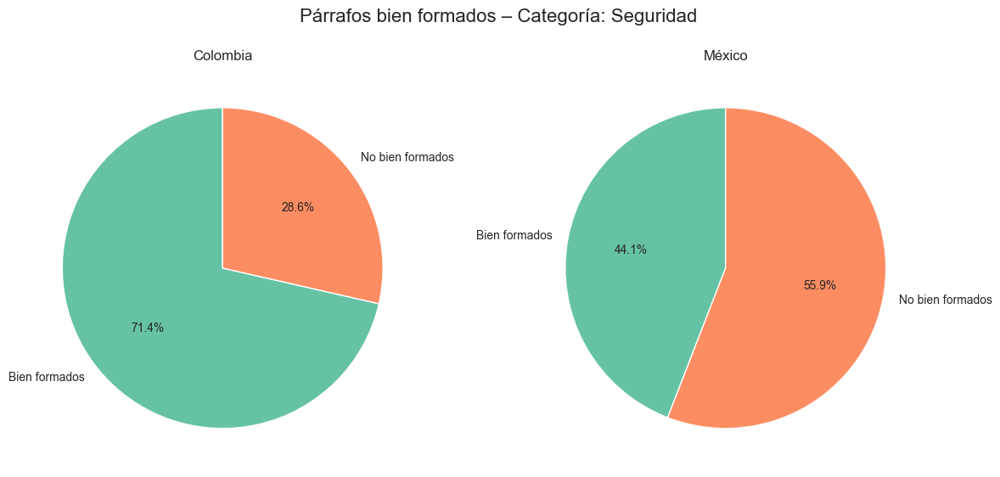

In [95]:
# Compute mean well-formed paragraphs per country and category
df_grouped = (
    df.groupby(["country", "category"])["well_formed_paragraph"]
    .mean()
    .reset_index()
)

df_grouped["well_formed_pct"] = df_grouped["well_formed_paragraph"] * 100
df_grouped["not_well_formed_pct"] = 100 - df_grouped["well_formed_pct"]

categories = df_grouped["category"].unique()

for category in categories:
    subset = df_grouped[df_grouped["category"] == category]

    fig, axes = plt.subplots(1, 2, figsize=(12,6))
    fig.suptitle(f"Párrafos bien formados – Categoría: {category}", fontsize=16)

    for ax, (idx, row) in zip(axes, subset.iterrows()):
        labels = ["Bien formados", "No bien formados"]
        sizes = [row["well_formed_pct"], row["not_well_formed_pct"]]
        ax.pie(sizes, labels=labels, autopct="%1.1f%%", startangle=90, colors=["#66c2a5","#fc8d62"])
        ax.set_title(row["country"])

    plt.tight_layout()
    plt.show()

### Paso 4.2: ¿Qué tan frecuentes son los encabezados útiles para formar preguntas?

In [96]:
# Asegurarnos de que los títulos sean strings
df["title"] = df["title"].astype(str)

In [97]:
def is_useful_title(text):
    doc = nlp(text)
    # Útil si hay un verbo o entidad nombrada
    has_verb = any(tok.pos_ == "VERB" for tok in doc)
    has_entity = any(ent.label_ in ["PER", "LOC", "ORG", "MISC"] for ent in doc.ents)
    return has_verb or has_entity

df["useful_title"] = df["title"].apply(is_useful_title)

In [98]:
freq_useful = df["useful_title"].mean() * 100
print(f"Porcentaje de títulos útiles: {freq_useful:.2f}%")

Porcentaje de títulos útiles: 98.21%


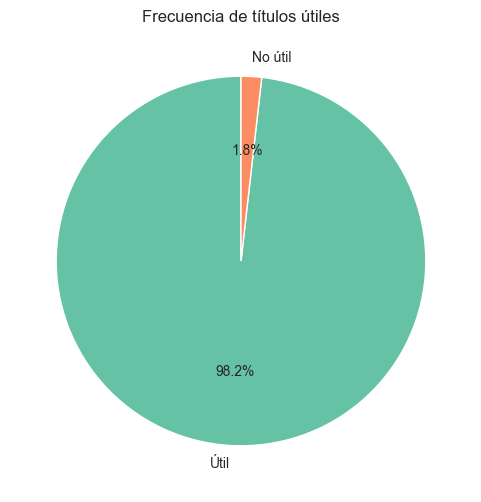

In [99]:
sizes = [
    df["useful_title"].sum(),
    len(df) - df["useful_title"].sum()
]
labels = ["Útil", "No útil"]
colors = ["#66c2a5","#fc8d62"]

plt.figure(figsize=(6,6))
plt.pie(sizes, labels=labels, autopct="%1.1f%%", startangle=90, colors=colors)
plt.title("Frecuencia de títulos útiles")
plt.show()

### Paso 4.3: ¿Cuántas entidades nombradas (personas, lugares, fechas, organizaciones) hay por texto?

In [100]:
# Count entities per text
df["num_entities"] = df["entities"].apply(lambda x: len(x) if isinstance(x, list) else 0)

# Quick summary
print(df[["num_entities"]].describe())

       num_entities
count   5635.000000
mean      17.469033
std       21.988457
min        0.000000
25%        5.000000
50%       11.000000
75%       22.000000
max      335.000000


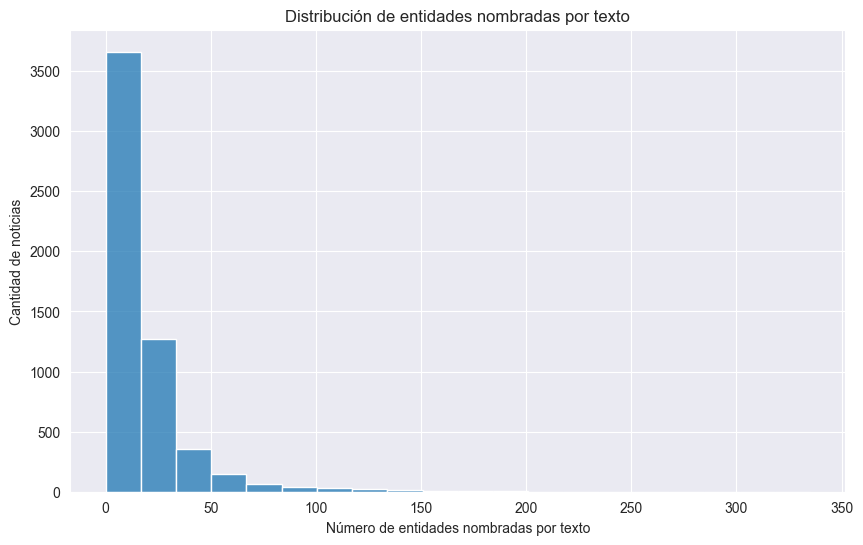

In [101]:
plt.figure(figsize=(10,6))
sns.histplot(df["num_entities"], bins=20, kde=False)
plt.xlabel("Número de entidades nombradas por texto")
plt.ylabel("Cantidad de noticias")
plt.title("Distribución de entidades nombradas por texto")
plt.show()

     country       category   count       mean        std   min   25%   50%  \
0   Colombia        Cultura  1118.0  21.906977  17.412946   0.0  10.0  19.0   
1   Colombia      Economica  1010.0   9.942574   8.538299   0.0   4.0   8.0   
2   Colombia  Internacional   556.0  18.140288  12.762915   0.0   8.0  16.0   
3   Colombia       Judicial   112.0   5.696429   4.553663   0.0   3.0   5.0   
4   Colombia       Politica   714.0  13.920168  12.302091   0.0   5.0  12.0   
5   Colombia          Salud   463.0   7.827214   7.269425   0.0   3.0   6.0   
6   Colombia      Seguridad     7.0  20.428571  11.296860  10.0  13.0  17.0   
7     México        Cultura   187.0   9.128342  15.802702   0.0   2.0   5.0   
8     México      Economica   200.0   6.785000   8.343070   0.0   1.0   4.0   
9     México  Internacional   449.0  51.204900  46.323618   0.0   9.0  46.0   
10    México       Judicial    96.0   5.895833   4.848177   0.0   3.0   5.0   
11    México       Politica   549.0  15.493625  14.8

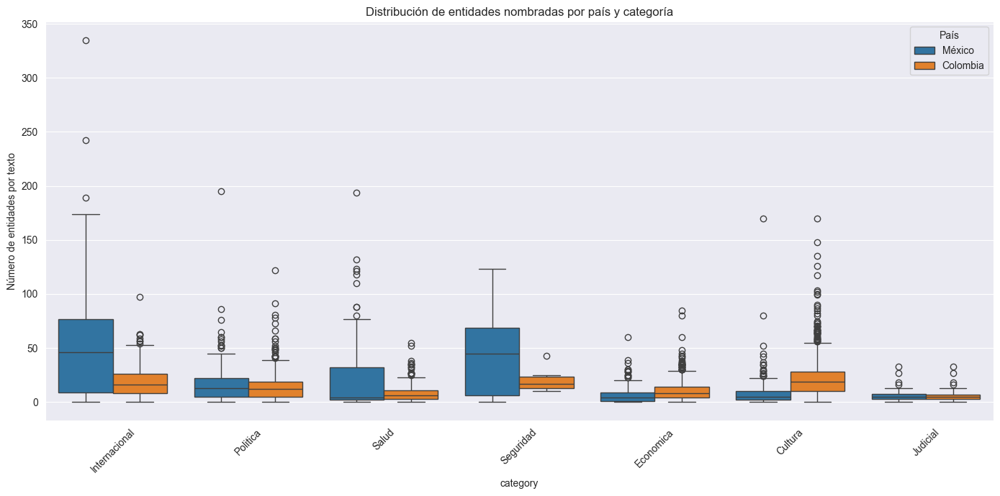

In [102]:
# Count entities per text (if not already done)
df["num_entities"] = df["entities"].apply(lambda x: len(x) if isinstance(x, list) else 0)

# Aggregate by country and category
agg_df = df.groupby(["country", "category"])["num_entities"].describe().reset_index()
print(agg_df[["country","category","count","mean","std","min","25%","50%","75%","max"]])

# Boxplot per country and category
plt.figure(figsize=(14,7))
sns.boxplot(data=df, x="category", y="num_entities", hue="country")
plt.xticks(rotation=45)
plt.ylabel("Número de entidades por texto")
plt.title("Distribución de entidades nombradas por país y categoría")
plt.legend(title="País")
plt.tight_layout()
plt.show()

### Paso 4.4: ¿Qué tipos de entidades predominan (PERSON, LOC, ORG, DATE, EVENT)?

  entity_type  entity_text
3         PER        51115
0         LOC        24926
1        MISC        11774
2         ORG        10623


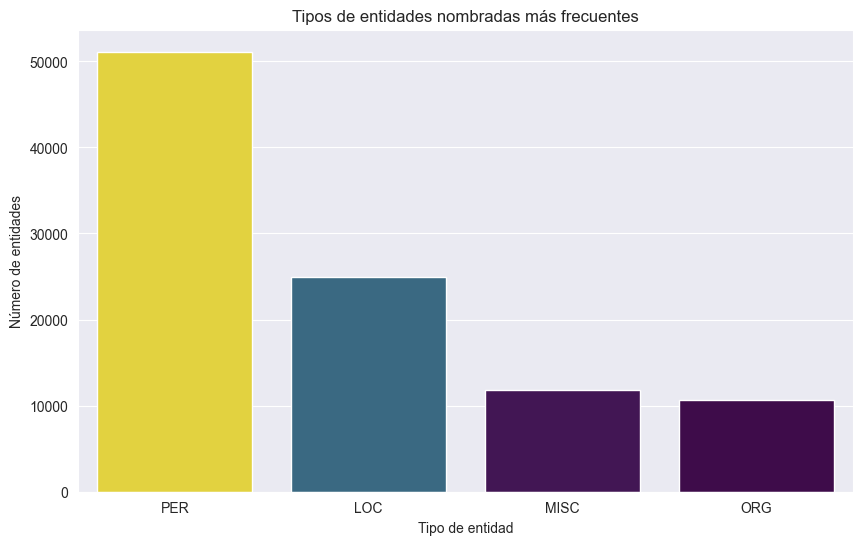

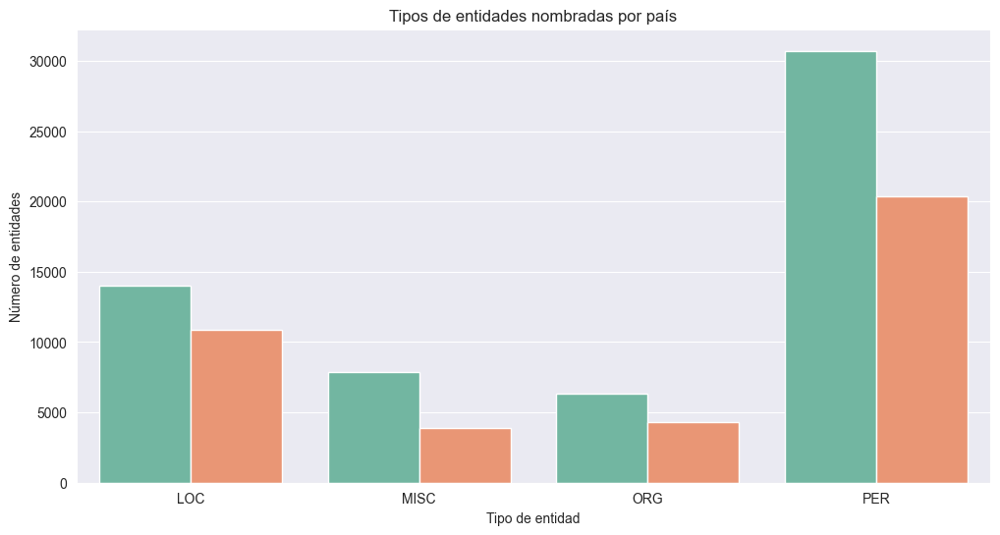

In [104]:
# Ensure 'entities' column has format [(text, type), ...]
df_entities = df.explode("entities").dropna(subset=["entities"])
df_entities["entity_text"] = df_entities["entities"].apply(lambda x: x[0] if isinstance(x, tuple) else None)
df_entities["entity_type"] = df_entities["entities"].apply(lambda x: x[1] if isinstance(x, tuple) else None)

# Count occurrences per entity type (overall)
entity_counts = df_entities.groupby("entity_type")["entity_text"].count().reset_index()
entity_counts = entity_counts.sort_values(by="entity_text", ascending=False)
print(entity_counts)

# Plot overall
plt.figure(figsize=(10,6))
sns.barplot(data=entity_counts, x="entity_type", y="entity_text", hue="entity_text", palette="viridis", legend=False)
plt.ylabel("Número de entidades")
plt.xlabel("Tipo de entidad")
plt.title("Tipos de entidades nombradas más frecuentes")
plt.show()

# Optional: By country
entity_counts_country = df_entities.groupby(["country","entity_type"])["entity_text"].count().reset_index()
plt.figure(figsize=(12,6))
sns.barplot(data=entity_counts_country, x="entity_type", y="entity_text", hue="country", palette="Set2", legend=False)
plt.ylabel("Número de entidades")
plt.xlabel("Tipo de entidad")
plt.title("Tipos de entidades nombradas por país")
plt.show()

### Paso 4.5: ¿Qué porcentaje de oraciones contiene información factual que podría servir como respuesta?

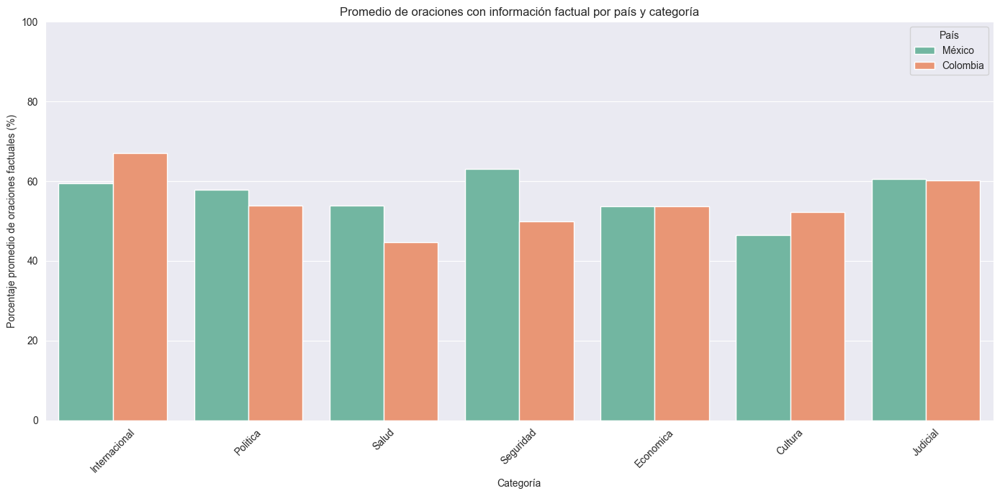

In [112]:
# Function to check if a sentence is factual
def is_factual(sentence, entities=[]):
    """
    Simple heuristic:
    - A sentence is factual if it contains a named entity or a number/date
    """
    if not sentence:
        return False
    for ent in entities:
        if isinstance(ent, tuple) and ent[0] in sentence:
            return True
    if any(char.isdigit() for char in sentence):
        return True
    return False

# Prepare a DataFrame to store results
rows = []

for country in df["country"].unique():
    for category in df["category"].unique():
        subset = df[(df["country"] == country) & (df["category"] == category)]
        percentages = []
        for _, row in subset.iterrows():
            sentences = row.get("content_sentence_tokenization", [])
            entities = row.get("entities", [])
            if not isinstance(sentences, list) or not sentences:
                continue
            factual = [s for s in sentences if is_factual(s, entities)]
            percentages.append(len(factual)/len(sentences))
        if percentages:
            rows.append({
                "country": country,
                "category": category,
                "factual_percentage": sum(percentages)/len(percentages) * 100
            })

plot_df = pd.DataFrame(rows)

# Plot with Seaborn using standard deviation as confidence interval
plt.figure(figsize=(14,7))
sns.barplot(
    data=plot_df,
    x="category",
    y="factual_percentage",
    hue="country",
    errorbar='sd',
    palette="Set2"
)
plt.ylabel("Porcentaje promedio de oraciones factuales (%)")
plt.xlabel("Categoría")
plt.title("Promedio de oraciones con información factual por país y categoría")
plt.ylim(0,100)
plt.xticks(rotation=45)
plt.legend(title="País")
plt.tight_layout()
plt.show()


In [113]:
# Overall average factual percentage across all texts
overall_avg = plot_df["factual_percentage"].mean()
print(f"Porcentaje promedio de oraciones factuales en todos los textos: {overall_avg:.2f}%")

Porcentaje promedio de oraciones factuales en todos los textos: 55.48%
